In [1]:
#!/usr/bin/env python3

# Copyright (c) Facebook, Inc. and its affiliates.
# This source code is licensed under the MIT license found in the
# LICENSE file in the root directory of this source tree.

import argparse
import os
import random
import sys
import time
from math import pi

import numpy as np
import matplotlib.pyplot as plt
import orbslam2
import PIL
import cv2
import requests
import torch
import torch.nn.functional as F

import habitat
from habitat.config.default import get_config
from habitat.sims.habitat_simulator.actions import HabitatSimActions
from habitat_baselines.config.default import get_config as cfg_baseline
from habitat_baselines.slambased.mappers import DirectDepthMapper
from habitat_baselines.slambased.monodepth import MonoDepthEstimator
from habitat_baselines.slambased.path_planners import DifferentiableStarPlanner
from habitat_baselines.slambased.reprojection import (
    get_direction,
    get_distance,
    habitat_goalpos_to_mapgoal_pos,
    homogenize_p,
    planned_path2tps,
    project_tps_into_worldmap,
    angle_to_pi_2_minus_pi_2 as norm_ang,
)
from habitat_baselines.slambased.utils import generate_2dgrid

GOAL_SENSOR_UUID = "pointgoal_with_gps_compass"
#GOAL_SENSOR_UUID = "objectgoal"


Bad key "text.kerning_factor" on line 4 in
/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.1.3/matplotlibrc.template
or from the matplotlib source distribution
/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.7/site-packages/tensorboard/compat/tensorflow_stub/dtypes.py:541: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/ubuntu/anaconda3/envs/pytorch_p36/lib/python3.7/site-packages/tensorboard/compat/tensorflow_stub/dtypes.py:542: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8

In [2]:
def download(url, filename):
    with open(filename, "wb") as f:
        response = requests.get(url, stream=True)
        total = response.headers.get("content-length")
        if total is None:
            f.write(response.content)
        else:
            downloaded = 0
            total = int(total)
            for data in response.iter_content(
                chunk_size=max(int(total / 1000), 1024 * 1024)
            ):
                downloaded += len(data)
                f.write(data)
                done = int(50 * downloaded / total)
                sys.stdout.write(
                    "\r[{}{}]".format("█" * done, "." * (50 - done))
                )
                sys.stdout.flush()
    sys.stdout.write("\n")


def ResizePIL2(np_img, size=256):
    im1 = PIL.Image.fromarray(np_img)
    return np.array(im1.resize((size, size)))


def make_good_config_for_orbslam2(config):
    config.SIMULATOR.AGENT_0.SENSORS = ["RGB_SENSOR", "DEPTH_SENSOR"]
    config.SIMULATOR.RGB_SENSOR.WIDTH = 640
    config.SIMULATOR.RGB_SENSOR.HEIGHT = 480
    config.SIMULATOR.DEPTH_SENSOR.WIDTH = 640
    config.SIMULATOR.DEPTH_SENSOR.HEIGHT = 480
    config.ORBSLAM2.CAMERA_HEIGHT = config.SIMULATOR.DEPTH_SENSOR.POSITION[
        1
    ]
    config.ORBSLAM2.H_OBSTACLE_MIN = (
        0.3 * config.ORBSLAM2.CAMERA_HEIGHT
    )
    config.ORBSLAM2.H_OBSTACLE_MAX = (
        1.0 * config.ORBSLAM2.CAMERA_HEIGHT
    )
    config.ORBSLAM2.MIN_PTS_IN_OBSTACLE = (
        config.SIMULATOR.DEPTH_SENSOR.WIDTH / 2.0
    )
    return


from PIL import Image
from examples.habitat_sim_py.utils.common import d3_40_colors_rgb
import numpy as np

def display_sample(rgb_obs, semantic_obs, depth_obs):
    rgb_img = Image.fromarray(rgb_obs, mode="RGB")
    
    semantic_img = Image.new("P", (semantic_obs.shape[1], semantic_obs.shape[0]))
    semantic_img.putpalette(d3_40_colors_rgb.flatten())
    semantic_img.putdata((semantic_obs.flatten() % 40).astype(np.uint8))
    semantic_img = semantic_img.convert("RGBA")
    
    depth_img = Image.fromarray((depth_obs * 255).astype(np.uint8), mode="L")

    arr = [rgb_img, semantic_img, depth_img]
    
    titles = ['rgb', 'semantic', 'depth']
    plt.figure(figsize=(12 ,8))
    for i, data in enumerate(arr):
        ax = plt.subplot(1, 3, i+1)
        ax.axis('off')
        ax.set_title(titles[i])
        plt.imshow(data)
    plt.show()

In [3]:
class RandomAgent(object):
    r"""Simplest agent, which returns random actions,
    until reach the goal
    """

    def __init__(self, config):
        super(RandomAgent, self).__init__()
        self.num_actions = config.NUM_ACTIONS
        self.dist_threshold_to_stop = config.DIST_TO_STOP
        self.reset()
        return

    def reset(self):
        self.steps = 0
        return

    def update_internal_state(self, habitat_observation):
        self.obs = habitat_observation
        self.steps += 1
        return

    def is_goal_reached(self):
        dist = self.obs[GOAL_SENSOR_UUID][0]
        return dist <= self.dist_threshold_to_stop

    def act(self, habitat_observation=None, random_prob=1.0):
        self.update_internal_state(habitat_observation)
        # Act
        # Check if we are done
        if self.is_goal_reached():
            action = HabitatSimActions.STOP
        else:
            action = random.randint(0, self.num_actions - 1)
        return {"action": action}


class BlindAgent(RandomAgent):
    def __init__(self, config):
        super(BlindAgent, self).__init__()
        self.pos_th = config.DIST_TO_STOP
        self.angle_th = config.ANGLE_TH
        self.reset()
        return

    def decide_what_to_do(self):
        distance_to_goal = self.obs[GOAL_SENSOR_UUID][0]
        angle_to_goal = norm_ang(np.array(self.obs[GOAL_SENSOR_UUID][1]))
        command = HabitatSimActions.STOP
        if distance_to_goal <= self.pos_th:
            return command
        if abs(angle_to_goal) < self.angle_th:
            command = HabitatSimActions.MOVE_FORWARD
        else:
            if (angle_to_goal > 0) and (angle_to_goal < pi):
                command = HabitatSimActions.TURN_LEFT
            elif angle_to_goal > pi:
                command = HabitatSimActions.TURN_RIGHT
            elif (angle_to_goal < 0) and (angle_to_goal > -pi):
                command = HabitatSimActions.TURN_RIGHT
            else:
                command = HabitatSimActions.TURN_LEFT

        return command

    def act(self, habitat_observation=None, random_prob=0.1):
        self.update_internal_state(habitat_observation)
        # Act
        if self.is_goal_reached():
            return HabitatSimActions.STOP
        command = self.decide_what_to_do()
        random_action = random.randint(0, self.num_actions - 1)
        act_randomly = np.random.uniform(0, 1, 1) < random_prob
        if act_randomly:
            action = random_action
        else:
            action = command
        return {"action": action}

In [4]:
sys.path.append('/home/azav/objectnav')
sys.path.append('/home/ubuntu/cs148')
from detector import GoalDetector

In [13]:
class ORBSLAM2Agent(RandomAgent):
    def __init__(self, config, device=torch.device("cuda:0"), print_attrs=False,
                 min_depth=None, max_depth=None, turn_angle=30):
        self.num_actions = config.NUM_ACTIONS
        self.dist_threshold_to_stop = config.DIST_TO_STOP
        self.slam_vocab_path = config.SLAM_VOCAB_PATH
        assert os.path.isfile(self.slam_vocab_path)
        self.slam_settings_path = config.SLAM_SETTINGS_PATH
        assert os.path.isfile(self.slam_settings_path)
        self.slam = orbslam2.System(
            self.slam_vocab_path, self.slam_settings_path, orbslam2.Sensor.RGBD
        )
        self.slam.set_use_viewer(False)
        self.slam.initialize()
        self.device = device
        self.map_size_meters = config.MAP_SIZE
        self.map_cell_size = config.MAP_CELL_SIZE
        self.pos_th = config.DIST_REACHED_TH
        self.next_wp_th = config.NEXT_WAYPOINT_TH
        self.angle_th = config.ANGLE_TH
        self.obstacle_th = config.MIN_PTS_IN_OBSTACLE
        self.depth_denorm = config.DEPTH_DENORM
        self.planned_waypoints = []
        self.mapper = DirectDepthMapper(
            camera_height=config.CAMERA_HEIGHT,
            near_th=config.D_OBSTACLE_MIN,
            far_th=config.D_OBSTACLE_MAX,
            h_min=config.H_OBSTACLE_MIN,
            h_max=config.H_OBSTACLE_MAX,
            map_size=config.MAP_SIZE,
            map_cell_size=config.MAP_CELL_SIZE,
            device=device,
        )
        self.planner = DifferentiableStarPlanner(
            max_steps=config.PLANNER_MAX_STEPS,
            preprocess=config.PREPROCESS_MAP,
            beta=config.BETA,
            device=device,
        )
        self.slam_to_world = 1.0
        self.timestep = 0.1
        self.timing = False
        self.reset()
        self.needs_inspection = True
        self.located_true_goal = False
        self.start_location = None
        self.start_rotation = None
        self.obstacle_ray_map = None
        self.to_do_list = []
        self.sweep_iteration = 0
        self.is_sweeping = False

        if min_depth is None:
            self.min_depth = config.D_OBSTACLE_MIN
        if max_depth is None:
            self.max_depth = config.D_OBSTACLE_MAX
        self.min_depth = min_depth
        self.max_depth = max_depth
        
        # print('self', self, dir(self))
        self.init_time = int(time.time())
        if print_attrs:
            for attr_name in dir(self):
                if '__' not in attr_name:
                    print(attr_name, getattr(self, attr_name), type(getattr(self, attr_name)))
                    type_name = str(type(getattr(self, attr_name)))
                    if 'numpy' in type_name or 'ensor' in type_name:
                        print(getattr(getattr(self, attr_name), 'shape'))
        self.turn_angle = turn_angle
        self.half_turn_rad = self.turn_angle * np.pi / 360
        self.device = device
        self.gd = GoalDetector()
        self.goal_location = None
        self.steps = 0
        
        return

    def reset(self):
        super(ORBSLAM2Agent, self).reset()
        self.offset_to_goal = None
        self.tracking_is_OK = False
        self.waypointPose6D = None
        self.unseen_obstacle = False
        self.action_history = []
        self.planned_waypoints = []
        self.map2DObstacles = self.init_map2d()
        n, ch, height, width = self.map2DObstacles.size()
        self.coordinatesGrid = generate_2dgrid(height, width, False).to(
            self.device
        )
        self.pose6D = self.init_pose6d()
        self.action_history = []
        self.pose6D_history = []
        self.position_history = []
        self.planned2Dpath = torch.zeros((0))
        self.slam.reset()
        self.cur_time = 0
        # Keep todo list as relatively, things don't change
        # self.to_do_list = []
        self.start_location = None
        self.start_rotation = None
        self.waypoint_id = 0
        self.sweep_iteration = 0
        if self.device != torch.device("cpu"):
            torch.cuda.empty_cache()
        return

    def update_internal_state(self, habitat_observation):
        # sets self.obs = observation
        super(ORBSLAM2Agent, self).update_internal_state(habitat_observation)

        self.cur_time += self.timestep
        rgb, depth = self.rgb_d_from_observation(habitat_observation)
        t = time.time()
        try:
            self.slam.process_image_rgbd(rgb, depth, self.cur_time)
            if self.timing:
                print(time.time() - t, "ORB_SLAM2")
            self.tracking_is_OK = str(self.slam.get_tracking_state()) == "OK"
        except BaseException as e:
            print("Warning!!!! ORBSLAM processing frame error")
            print("orbslam error:", e)
            self.tracking_is_OK = False
        if not self.tracking_is_OK:
            print("\n\n\n\nRESETTING MYSELF BC TRACKING NOT OKAY\n\n\n\n")
            print("SLAM TRACKING STATE:", self.slam.get_tracking_state())
            self.reset()
        t = time.time()

        if self.start_location is None:
            self.start_location = habitat_observation['gps']
        if self.start_rotation is None:
            self.start_rotation = habitat_observation['compass']
        
        self.set_offset_to_goal(habitat_observation)
        if self.tracking_is_OK:
            trajectory_history = np.array(self.slam.get_trajectory_points())
            self.pose6D = homogenize_p(
                torch.from_numpy(trajectory_history[-1])[1:]
                .view(3, 4)
                .to(self.device)
            ).view(1, 4, 4)
            self.trajectory_history = trajectory_history
            if len(self.position_history) > 1:
                previous_step = get_distance(
                    self.pose6D.view(4, 4),
                    torch.from_numpy(self.position_history[-1])
                    .view(4, 4)
                    .to(self.device),
                )
                if self.action_history[-1] == HabitatSimActions.MOVE_FORWARD:
                    self.unseen_obstacle = (
                        previous_step.item() <= 0.01
                    )  # hardcoded threshold for not moving
                    if self.unseen_obstacle:
                        self.sweep_iteration += 1
                        print("\nINCREASED SWEEP ITERATION TO:", self.sweep_iteration)
                    else:
                        if self.is_sweeping:
                            self.is_sweeping = False
                            while len(self.to_do_list) > 0:
                                action = self.to_do_list.pop(0)
                                if type(action) is list and 'LAST_SWEEP_ACTION' in action:
                                    # Remember to look back up
                                    self.to_do_list.append(action)
                                    break

        current_obstacles = self.mapper(
            torch.from_numpy(depth).to(self.device).squeeze(), self.pose6D
        ).to(self.device)
        self.current_obstacles = current_obstacles
        self.map2DObstacles = torch.max(
            self.map2DObstacles, current_obstacles.unsqueeze(0).unsqueeze(0)
        )
        if self.timing:
            print(time.time() - t, "Mapping")
        return True

    def init_pose6d(self):
        return torch.eye(4).float().to(self.device)

    def map_size_in_cells(self):
        return int(self.map_size_meters / self.map_cell_size)

    def init_map2d(self):
        return (
            torch.zeros(
                1, 1, self.map_size_in_cells(), self.map_size_in_cells()
            )
            .float()
            .to(self.device)
        )

    def get_orientation_on_map(self):
        self.pose6D = self.pose6D.view(1, 4, 4)
        return torch.tensor(
            [
                [self.pose6D[0, 0, 0], self.pose6D[0, 0, 2]],
                [self.pose6D[0, 2, 0], self.pose6D[0, 2, 2]],
            ]
        )

    def get_position_on_map(self, do_floor=True):
        return project_tps_into_worldmap(
            self.pose6D.view(1, 4, 4),
            self.map_cell_size,
            self.map_size_meters,
            do_floor,
        )

    def act(self, habitat_observation, random_prob=0.1):
        # Update internal state
        t = time.time()
        cc = 0
        update_is_ok = self.update_internal_state(habitat_observation)
        while not update_is_ok:
            update_is_ok = self.update_internal_state(habitat_observation)
            cc += 1
            if cc > 2:
                break
        if self.timing:
            print(time.time() - t, " s, update internal state")
        self.position_history.append(
            self.pose6D.detach().cpu().numpy().reshape(1, 4, 4)
        )
        success = self.is_goal_reached()
        if success:
            print("\n\n\nGOAL IS BELIEVED TO BE REACHED before planning\n\n\n")
            action = HabitatSimActions.STOP
            self.action_history.append(action)
            return {"action": action}
        # Plan action
        t = time.time()
        
        if self.needs_inspection:
            # do a left turn 360
            # each turn is 15 degrees
            self.to_do_list.extend(
                [HabitatSimActions.TURN_LEFT] * 24
            )
            self.needs_inspection = False

        if len(self.to_do_list) > 0:
            # pop from to do list queue
            action = self.to_do_list.pop(0)
            # to do list can contain auxiliary commands
            if type(action) is list:
                for aux_command in action[1:]:
                    if aux_command == 'LAST_SWEEP_ACTION':
                        self.is_sweeping = False
                action = action[0]
            
            self.action_history.append(action)
            return {"action": action}

        print("\n\nTo do list is empty, needs inspection?:",
              self.needs_inspection)

        # find a goal and then go to it
        # after reaching the goal, get inspection again
        
        self.planned2Dpath, self.planned_waypoints = self.plan_path()
        if self.timing:
            print(time.time() - t, " s, Planning")
        t = time.time()
        # Act
        if self.waypointPose6D is None:
            self.waypointPose6D = self.get_valid_waypoint_pose6d()
        if (
            self.is_waypoint_reached(self.waypointPose6D)
            or not self.tracking_is_OK
        ):
            self.waypointPose6D = self.get_valid_waypoint_pose6d()
            self.waypoint_id += 1
        action = self.decide_what_to_do()
        # May be random? ALEX: LETS NOT
#         random_action = random.randint(0, self.num_actions - 1)
#         what_to_do = np.random.uniform(0, 1, 1)
#         if what_to_do < random_prob:
#             action = random_action
        if self.timing:
            print(time.time() - t, " s, get action")
        self.action_history.append(action)
        if action == 0:
            print("\n\n\nGOAL IS BELIEVED TO BE REACHED after planning\n\n\n")
        return {"action": action}

    def is_waypoint_good(self, pose6d):
        # Is it far enough?
        p_init = self.pose6D.squeeze()
        dist_diff = get_distance(p_init, pose6d)
        valid = dist_diff > self.next_wp_th
        return valid.item()

    def is_waypoint_reached(self, pose6d):
        p_init = self.pose6D.squeeze()
        dist_diff = get_distance(p_init, pose6d)
        reached = dist_diff <= self.pos_th
        return reached.item()

    def get_waypoint_dist_dir(self):
        angle = get_direction(
            self.pose6D.squeeze(), self.waypointPose6D.squeeze(), 0, 0
        )
        dist = get_distance(
            self.pose6D.squeeze(), self.waypointPose6D.squeeze()
        )
        return torch.cat(
            [
                dist.view(1, 1),
                torch.sin(angle).view(1, 1),
                torch.cos(angle).view(1, 1),
            ],
            dim=1,
        )

    def get_valid_waypoint_pose6d(self):
        p_next = self.planned_waypoints[0]
        while not self.is_waypoint_good(p_next):
            if len(self.planned_waypoints) > 1:
                self.planned_waypoints = self.planned_waypoints[1:]
                p_next = self.planned_waypoints[0]
            else:
                p_next = self.estimatedGoalPos6D.squeeze()
                break
        return p_next

    def is_goal_reached(self):
        if self.obs.get("pointgoal_with_gps_compass") is None:
            dist = self.obs["explorationgoal"][0]
        else:
            dist = self.obs["pointgoal_with_gps_compass"][0]
        return dist <= self.dist_threshold_to_stop

    
    def find_object_goal(self, observation):
        """
        call the object detector and see if the goal is in view. if so, lock it down!
        """
        if self.goal_location is None:
            depth = observation['depth'][:, :, 0] * (self.max_depth - self.min_depth) + self.min_depth
            goalpos_rel = self.gd.detect_goal(depth, goal_class=observation['objectgoal'][0])
            if not (goalpos_rel is None):
                print("\n\n\nGOOOOOOOOALLLLLLLLLLLL GOAL GOAL GOALLLLLLLLLL\n\n")
                cmp = observation['compass'][0]
                rotated = [goalpos_rel[1] * np.cos(cmp) + goalpos_rel[0] * np.sin(cmp), 
                           -goalpos_rel[1] * np.sin(cmp) + goalpos_rel[0] * np.cos(cmp)]
                self.goal_location = observation['gps'] + np.array(rotated)
        if not (self.goal_location is None):
            diff = self.goal_location - observation['gps']

            ang = np.angle(complex(diff[0], -diff[1])) - observation['compass'][0]
            pointgoal = np.array([np.linalg.norm(diff), ang % (2 * np.pi)])
            print('GOAL (DIST, ANG): ', pointgoal)
            return pointgoal
        else:
            return None


    def plan_exploration(self, observation):
        """
        If just exploring, shoot rays outwards from current location, and go to the ray
        that can go the farthest without hitting and object
        """
        num_rays = 72
        curr_rays = [2 * np.pi / num_rays * i for i in range(num_rays)]
        dist_step = 0.1
        max_dist = 10
        location_in_obs_map = (observation['gps'] - self.start_location).astype(int) * 10 + 200

        if 'numpy' in str(type(self.map2DObstacles)): 
            np_obs_map = (self.map2DObstacles > self.obstacle_th).astype(np.uint8)
        else:
            np_obs_map = (self.map2DObstacles[0,0].cpu().numpy() > self.obstacle_th).astype(np.uint8)

        # kernel for image closing
        kernel = np.ones((3,3),np.uint8)            
        np_obs_map = cv2.morphologyEx(np_obs_map, cv2.MORPH_CLOSE, kernel)

        best_ray = None
        best_coord = None
        best_dist = None

        for n_steps in range(int(max_dist / dist_step)):
            curr_dist = n_steps * dist_step
            next_rays = []
            for ray in curr_rays:
                y_coord = int(np.cos(ray) * curr_dist * 10 + location_in_obs_map[0])
                x_coord = int(-np.sin(ray) * curr_dist * 10 + location_in_obs_map[1])
                if np_obs_map[y_coord, x_coord] != 1:
                    next_rays.append(ray)
                    # color in map to visualize
                    np_obs_map[y_coord, x_coord] = 2

                    if curr_dist == best_dist:
                        curr_ray_angle_delta = norm_ang(ray - float(observation['compass']))
                        best_ray_angle_delta = norm_ang(best_ray - float(observation['compass']))
                        if abs(curr_ray_angle_delta) > abs(best_ray_angle_delta):
                            continue
                                            
                    best_dist = curr_dist
                    best_coord = [y_coord, x_coord]
                    best_ray = ray
            
            if len(next_rays) > 0:
                curr_rays = next_rays
            else:
                break

        if best_dist is None:
            return None

        # color in best ray:
        for n_steps in range(int(best_dist // dist_step)):
            curr_dist = n_steps * dist_step
            y_coord = int(np.cos(best_ray) * curr_dist * 10 + location_in_obs_map[0])
            x_coord = int(-np.sin(best_ray) * curr_dist * 10 + location_in_obs_map[1])
            np_obs_map[y_coord, x_coord] = 4

        self.obstacle_ray_map = np_obs_map
        
        # translate coord to absolute and relative location
        best_gps_coord = np.array([
            (y_coord - 200) / 10,
            (x_coord - 200) / 10,
        ]) + self.start_location

        best_relative_coord = best_gps_coord - observation['gps']

        rotation_from_start = observation['compass'] - self.start_rotation
        # assuming compass is counterclockwise from y+
        best_relative_polar_coord = np.array([
            np.linalg.norm(best_relative_coord),
            # substract 90 deg because arctan is from x+ axis
            float((np.arctan2(best_relative_coord[0], best_relative_coord[1]) - np.pi / 2)
                  - observation['compass'])
        ])
        print('start location {}, start rotation {}'.format(
            self.start_location, self.start_rotation
        ))
        print(
            '''ray {}, dist {}, coord {}, gps coord {}, my gps {},
               my compass {}, relative coord {}, rel polar coord {}'''.format(
                best_ray,
                max_dist,
                best_coord,
                best_gps_coord,
                observation['gps'],
                observation['compass'],
                best_relative_coord,
                best_relative_polar_coord,
            )
        )
        return best_relative_polar_coord
        

    def set_offset_to_goal(self, observation):
        """ ID mappings"""
        obj_to_id = {'chair': 0, 'table': 1, 'picture': 2, 'cabinet': 3, 'cushion': 4, 'sofa': 5, 'bed': 6, 'chest_of_drawers': 7, 'plant': 8, 'sink': 9, 'toilet': 10, 'stool': 11, 'towel': 12, 'tv_monitor': 13, 'shower': 14, 'bathtub': 15, 'counter': 16, 'fireplace': 17, 'gym_equipment': 18, 'seating': 19, 'clothes': 20}
        id_to_obj = {obj_to_id[key]: key for key in obj_to_id}
        if GOAL_SENSOR_UUID == 'objectgoal':
            # [distance to goal in metres, angle to goal in radians]
            # Take the existing goal and find your offset from it
            self.obs["pointgoal_with_gps_compass"] = self.find_object_goal(observation)
            if self.obs["pointgoal_with_gps_compass"] is None:
                self.obs["explorationgoal"] = self.plan_exploration(observation)
                
                # doesn't see viable rays. this is not good
                if self.obs["explorationgoal"] is None:
                    print("\n\nWarning: no viable rays found, just moving forward\n\n")
                    # Just ask the robot to move forward
                    self.obs["explorationgoal"] = np.array([2.0, 0.0])
            print('class observation from goal', id_to_obj[observation[GOAL_SENSOR_UUID][0]])
            
        if self.obs["pointgoal_with_gps_compass"] is not None:
            if self.located_true_goal is False:
                self.located_true_goal = True
                # Reset waypoints and to do list
                self.waypointPose6D = None
                self.planned_waypoints = []
                self.planned2Dpath = torch.zeros((0))
                self.waypoint_id = 0
                self.to_do_list = []

            self.offset_to_goal = (
                    torch.from_numpy(self.obs["pointgoal_with_gps_compass"])
                    .float()
                    .to(self.device)
            )
        else:
            self.offset_to_goal = (
                    torch.from_numpy(self.obs["explorationgoal"])
                    .float()
                    .to(self.device)
            )
        print('\n\n\nostensible observation from goal', self.offset_to_goal)
        self.estimatedGoalPos2D = habitat_goalpos_to_mapgoal_pos(
            self.offset_to_goal,
            self.pose6D.squeeze(),
            self.map_cell_size,
            self.map_size_meters,
        )
        self.estimatedGoalPos6D = planned_path2tps(
            [self.estimatedGoalPos2D],
            self.map_cell_size,
            self.map_size_meters,
            1.0,
        ).to(self.device)[0]
        # {'STOP': 0, 'MOVE_FORWARD': 1, 'TURN_LEFT': 2, 'TURN_RIGHT': 3, 'LOOK_UP': 4, 'LOOK_DOWN': 5}
        # https://github.com/facebookresearch/habitat-api/blob/master/habitat/sims/habitat_simulator/actions.py
        log_attrs = [
            #'pose6D',
            'estimatedGoalPos2D',
            #'estimatedGoalPos6D',
            'action_history', 'cur_time', 'steps', 'located_true_goal', 'is_sweeping'
        ]
        for attr in log_attrs:
            print(attr, getattr(self, attr))
#         if len(self.position_history) > 0:
#             print("most recent position:", self.position_history[-1])
       #  print('num obstacles:', self.map2DObstacles.sum())
        print('gps and compass:', observation['gps'], observation['compass'])
        
        # Log the 2D obstacles map and observations
        if self.map2DObstacles is not None:
            map_dir = 'maps/' + GOAL_SENSOR_UUID + '_' + str(self.init_time)
            if not os.path.exists(map_dir):
                os.mkdir(map_dir)
            suffix = str(int(time.time())) + '_' + str(int(self.map2DObstacles.sum()))
            np.savez_compressed(map_dir + '/obstacle_map_' +
                       suffix + '.npz',
                       self.map2DObstacles[0,0].cpu().numpy())
            if self.obstacle_ray_map is not None:
                np.savez_compressed(map_dir + '/obstacle_ray_map_' +
                           suffix + '.npz',
                           self.obstacle_ray_map)
            
            path_map = (self.map2DObstacles[0,0].cpu().numpy() > self.obstacle_th).astype(np.uint8)
                
            if self.planned2Dpath is not None and len(self.planned2Dpath) > 0:
                location_in_obs_map = (observation['gps'] - self.start_location).astype(int) * 10 + 200
                
                for i in range(-1, 2):
                    for j in range(-1, 2):
                        y = location_in_obs_map[0] + i
                        x = location_in_obs_map[0] + j
                        if y > 0 and y < 400 and x > 0 and x < 400:
                            path_map[y, x] = 6
                
                for wp in self.planned2Dpath:
                    wp = wp.cpu().numpy().astype(int)
                    path_map[wp[0], wp[1]] = 4
                print("my gps location on obs map {}, my path start location on obs map {}".format(
                    location_in_obs_map, self.planned2Dpath[0].cpu().numpy().astype(int)
                ))

            np.savez_compressed(map_dir + '/path_map_' +
                       suffix + '.npz',
                       path_map)
                
            PIL.Image.fromarray(observation['rgb']).save(map_dir + '/rgb_' + suffix + '.png')
            PIL.Image.fromarray(
                (observation['depth'] * 255).astype(np.uint8).squeeze(2), 'L'
            ).save(map_dir + '/depth_' + suffix + '.png')
        return

    def rgb_d_from_observation(self, habitat_observation):
        rgb = habitat_observation["rgb"]
        depth = None
        if "depth" in habitat_observation:
            depth = self.depth_denorm * habitat_observation["depth"]
        return rgb, depth

    def prev_plan_is_not_valid(self):
        if len(self.planned2Dpath) == 0:
            return True
        pp = torch.cat(self.planned2Dpath).detach().cpu().view(-1, 2)
        binary_map = self.map2DObstacles.squeeze().detach() >= self.obstacle_th
        obstacles_on_path = (
            binary_map[pp[:, 0].long(), pp[:, 1].long()]
        ).long().sum().item() > 0
        return obstacles_on_path  # obstacles_nearby or  obstacles_on_path

    def rawmap2_planner_ready(self, rawmap, start_map, goal_map):
        map1 = (rawmap / float(self.obstacle_th)) ** 2
        map1 = (
            torch.clamp(map1, min=0, max=1.0)
            - start_map
            - F.max_pool2d(goal_map, 3, stride=1, padding=1)
        )
        return torch.relu(map1)
    
    def plan_path(self, overwrite=False):
        t = time.time()
        if (
            (not self.prev_plan_is_not_valid())
            and (not overwrite)
            and (len(self.planned_waypoints) > 0)
        ):
            return self.planned2Dpath, self.planned_waypoints
        print("\n\n\nDecided to plan again. why? prev plan invalid?", self.prev_plan_is_not_valid(),
              "overwrite?", overwrite,
              "length of waypoints?", len(self.planned_waypoints))
        self.waypointPose6D = None
        # Use GPS instead of localized location
        # current_pos = self.get_position_on_map()
        location_in_obs_map = (self.obs['gps'] - self.start_location).astype(int) * 10 + 200
        current_pos = torch.Tensor([location_in_obs_map])
        start_map = torch.zeros_like(self.map2DObstacles).to(self.device)
        start_map[
            0, 0, current_pos[0, 0].long(), current_pos[0, 1].long()
        ] = 1.0
        goal_map = torch.zeros_like(self.map2DObstacles).to(self.device)
        goal_map[
            0,
            0,
            self.estimatedGoalPos2D[0, 0].long(),
            self.estimatedGoalPos2D[0, 1].long(),
        ] = 1.0
        path, cost = self.planner(
            self.rawmap2_planner_ready(
                self.map2DObstacles, start_map, goal_map
            ).to(self.device),
            self.coordinatesGrid.to(self.device),
            goal_map.to(self.device),
            start_map.to(self.device),
        )
        if len(path) == 0:
            return path, []
        if self.timing:
            print(time.time() - t, " s, Planning")
        t = time.time()
        planned_waypoints = planned_path2tps(
            path, self.map_cell_size, self.map_size_meters, 1.0, False
        ).to(self.device)
        print("\n\nGiven start: {}, end: {}".format(current_pos, self.estimatedGoalPos2D))
        print("Path: {}\n\n".format(path))
        return path, planned_waypoints

    def planner_prediction_to_command(self, p_next):
        command = HabitatSimActions.STOP
        p_init = self.pose6D.squeeze()
        d_angle_rot_th = self.angle_th
        pos_th = self.pos_th
        d_distance = get_distance(p_init, p_next)
        if d_distance <= pos_th:
            return command
        d_angle = norm_ang(
            get_direction(p_init, p_next, ang_th=d_angle_rot_th, pos_th=pos_th)
        )
        print("\n\np_init {}\np_next {}\nd_angle {}\ndistance {}\n\n".format(
            p_init, p_next, d_angle, d_distance
        ))
        if abs(d_angle) < d_angle_rot_th:
            command = HabitatSimActions.MOVE_FORWARD
        else:
            if (d_angle > 0) and (d_angle < pi):
                command = HabitatSimActions.TURN_LEFT
            elif d_angle > pi:
                command = HabitatSimActions.TURN_RIGHT
            elif (d_angle < 0) and (d_angle > -pi):
                command = HabitatSimActions.TURN_RIGHT
            else:
                command = HabitatSimActions.TURN_LEFT
        return command

    def decide_what_to_do(self):
        action = None
        if self.is_goal_reached():
            if self.located_true_goal:
                print("LOCATED TRUE GOAL, STOPPING")
                action = HabitatSimActions.STOP
            else:
                print("LOCATED EXPLORATION GOAL, TURNING TEMPORARILY")
                action = HabitatSimActions.TURN_LEFT
                self.needs_inspection = True
            return action
        if self.unseen_obstacle:
            print("\nWAS UNABLE TO MOVE FORWARD DUE TO UNSEEN OBSTACLE. DOING SWEEP\n")
            command = HabitatSimActions.TURN_RIGHT
            self.is_sweeping = True
            sweep_amount = (self.sweep_iteration // 2) + 4
            self.to_do_list.extend(
                [HabitatSimActions.LOOK_DOWN] +
                [HabitatSimActions.TURN_RIGHT] * (sweep_amount - 1) +
                [HabitatSimActions.MOVE_FORWARD] +
                [HabitatSimActions.TURN_LEFT] * sweep_amount +
                [HabitatSimActions.MOVE_FORWARD] +
                [HabitatSimActions.TURN_LEFT] * sweep_amount +
                [HabitatSimActions.MOVE_FORWARD] +
                [HabitatSimActions.TURN_RIGHT] * sweep_amount +
                [HabitatSimActions.MOVE_FORWARD] + 
                [[HabitatSimActions.LOOK_UP, 'LAST_SWEEP_ACTION']]
            )
            self.unseen_obstacle = False
            return command
    
        # This is if we have found the real goal
        if self.goal_location is not None:
            dist, ang = self.obs["pointgoal_with_gps_compass"]
            if ang > self.half_turn_rad and ang < np.pi:
                action = HabitatSimActions.TURN_LEFT
            elif ang >= np.pi and ang < 2 * np.pi - self.half_turn_rad:
                action = HabitatSimActions.TURN_RIGHT
            else:
                action = HabitatSimActions.MOVE_FORWARD
            self.action_history.append(action)
            return action

        command = HabitatSimActions.STOP
        command = self.planner_prediction_to_command(self.waypointPose6D)
        return command

In [6]:
class ORBSLAM2MonodepthAgent(ORBSLAM2Agent):
    def __init__(
        self,
        config,
        device=torch.device("cuda:0"),
        monocheckpoint="habitat_baselines/slambased/data/mp3d_resnet50.pth",
    ):
        self.num_actions = config.NUM_ACTIONS
        self.dist_threshold_to_stop = config.DIST_TO_STOP
        self.slam_vocab_path = config.SLAM_VOCAB_PATH
        assert os.path.isfile(self.slam_vocab_path)
        self.slam_settings_path = config.SLAM_SETTINGS_PATH
        assert os.path.isfile(self.slam_settings_path)
        self.slam = orbslam2.System(
            self.slam_vocab_path, self.slam_settings_path, orbslam2.Sensor.RGBD
        )
        self.slam.set_use_viewer(False)
        self.slam.initialize()
        self.device = device
        self.map_size_meters = config.MAP_SIZE
        self.map_cell_size = config.MAP_CELL_SIZE
        self.pos_th = config.DIST_REACHED_TH
        self.next_wp_th = config.NEXT_WAYPOINT_TH
        self.angle_th = config.ANGLE_TH
        self.obstacle_th = config.MIN_PTS_IN_OBSTACLE
        self.depth_denorm = config.DEPTH_DENORM
        self.planned_waypoints = []
        self.mapper = DirectDepthMapper(
            camera_height=config.CAMERA_HEIGHT,
            near_th=config.D_OBSTACLE_MIN,
            far_th=config.D_OBSTACLE_MAX,
            h_min=config.H_OBSTACLE_MIN,
            h_max=config.H_OBSTACLE_MAX,
            map_size=config.MAP_SIZE,
            map_cell_size=config.MAP_CELL_SIZE,
            device=device,
        )
        self.planner = DifferentiableStarPlanner(
            max_steps=config.PLANNER_MAX_STEPS,
            preprocess=config.PREPROCESS_MAP,
            beta=config.BETA,
            device=device,
        )
        self.slam_to_world = 1.0
        self.timestep = 0.1
        self.timing = False
        self.checkpoint = monocheckpoint
        if not os.path.isfile(self.checkpoint):
            mp3d_url = "http://cmp.felk.cvut.cz/~mishkdmy/navigation/mp3d_ft_monodepth_resnet50.pth"
            suncg_me_url = "http://cmp.felk.cvut.cz/~mishkdmy/navigation/suncg_me_resnet.pth"
            suncg_mf_url = "http://cmp.felk.cvut.cz/~mishkdmy/navigation/suncg_mf_resnet.pth"
            url = mp3d_url
            print("No monodepth checkpoint found. Downloading...", url)
            download(url, self.checkpoint)
        self.monodepth = MonoDepthEstimator(self.checkpoint)
        self.reset()
        return

    def rgb_d_from_observation(self, habitat_observation):
        rgb = habitat_observation["rgb"]
        depth = ResizePIL2(
            self.monodepth.compute_depth(
                PIL.Image.fromarray(rgb).resize((320, 320))
            ),
            256,
        )  # /1.75
        depth[depth > 3.0] = 0
        depth[depth < 0.1] = 0
        return rgb, np.array(depth).astype(np.float32)

In [14]:
parser = argparse.ArgumentParser()
parser.add_argument(
    "--agent-type",
    default="orbslam2-rgbd",
    choices=["blind", "orbslam2-rgbd", "orbslam2-rgb-monod"],
)
parser.add_argument(
    "--task-config", type=str, default="tasks/pointnav_rgbd.yaml"
)
parser.add_argument(
    "--goal-sensor-uuid", type=str, default="pointgoal_with_gps_compass"
)
args = parser.parse_args([
    "--task-config", "configs/tasks/objectnav_mp3d_fast.yaml",
    "--goal-sensor-uuid", "objectgoal"
])

global GOAL_SENSOR_UUID
GOAL_SENSOR_UUID = args.goal_sensor_uuid

config = get_config()
agent_config = cfg_baseline()
agent_config.defrost()
config.defrost()
config.ORBSLAM2 = agent_config.ORBSLAM2
config.ORBSLAM2.DIST_REACHED_TH = 0.5
config.ORBSLAM2.NEXT_WAYPOINT_TH = 1
config.ORBSLAM2.DIST_TO_STOP = 0.2

#config.BASELINE = agent_config.BASELINE
make_good_config_for_orbslam2(config)

In [8]:
task_config = habitat.get_config(config_paths=args.task_config)
env = None
env = habitat.Env(config=task_config)
original_episodes = env.episodes
print("original number of episodes:", len(env.episodes))
env.episodes = [env.episodes[0]]

2020-06-03 09:23:41,688 Initializing dataset ObjectNav-v1
2020-06-03 09:23:41,736 initializing sim Sim-v0
I0603 09:23:49.083545 17024 simulator.py:142] Loaded navmesh data/scene_datasets/mp3d/x8F5xyUWy9e/x8F5xyUWy9e.navmesh
2020-06-03 09:23:49,092 Initializing task ObjectNav-v1


original number of episodes: 30


In [9]:
min_depth = task_config.SIMULATOR.DEPTH_SENSOR.MIN_DEPTH
max_depth = task_config.SIMULATOR.DEPTH_SENSOR.MAX_DEPTH
turn_angle = task_config.SIMULATOR.TURN_ANGLE

In [15]:
if args.agent_type == "blind":
    agent = BlindAgent(config.ORBSLAM2)
elif args.agent_type == "orbslam2-rgbd":
    agent = ORBSLAM2Agent(config.ORBSLAM2, min_depth=min_depth,
                          max_depth=max_depth, turn_angle=turn_angle)
elif args.agent_type == "orbslam2-rgb-monod":
    agent = ORBSLAM2MonodepthAgent(config.ORBSLAM2)
else:
    raise ValueError(args.agent_type, "is unknown type of agent")

In [16]:
observations = env.reset()
print(
    observations['rgb'].shape, observations['depth'].shape, observations['objectgoal'], \
    observations['compass'], observations['gps']
)

(480, 640, 3) (480, 640, 1) [12] [2.5218767e-09] [-0.  0.]


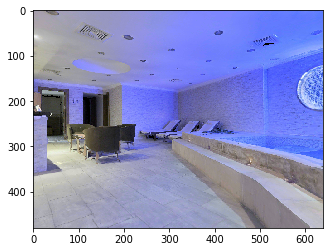

start location [-6.4899683 -4.1031938], start rotation [-1.0270878]
ray 5.235987755982989, dist 10, coord [249, 285], gps coord [-1.6899683   4.29680624], my gps [-6.4899683 -4.1031938],
               my compass [-1.0270878], relative coord [4.8 8.4], rel polar coord [ 9.6747093  -0.02456236]
class observation from goal towel



ostensible observation from goal tensor([ 9.6747, -0.0246], device='cuda:0')
estimatedGoalPos2D tensor([[297., 203.]], device='cuda:0')
action_history []
cur_time 0.1
steps 1
located_true_goal False
gps and compass: [-6.4899683 -4.1031938] [-1.0270878]


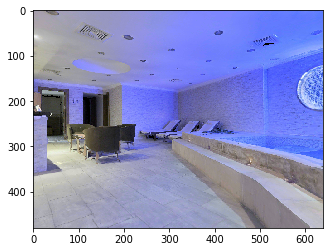




GOOOOOOOOALLLLLLLLLLLL GOAL GOAL GOALLLLLLLLLL


GOAL (DIST, ANG):  [4.20781148 0.13527067]
class observation from goal chair



ostensible observation from goal tensor([4.2078, 0.1353], device='cuda:0')
estimatedGoalPos2D tensor([[242., 195.]], device='cuda:0')
action_history [2]
cur_time 0.2
steps 2
located_true_goal True
gps and compass: [-6.4899683 -4.1031938] [-0.7652884]


To do list is empty, needs inspection?: False



Decided to plan again. why? prev plan invalid? True overwrite? False length of waypoints? 0


Given start: tensor([[200., 200.]]), end: tensor([[242., 195.]], device='cuda:0')
Path: [tensor([200., 200.]), tensor([201., 200.]), tensor([202., 200.]), tensor([203., 200.]), tensor([204., 200.]), tensor([205., 200.]), tensor([206., 200.]), tensor([207., 200.]), tensor([208., 200.]), tensor([209., 200.]), tensor([210., 200.]), tensor([211., 200.]), tensor([212., 200.]), tensor([213., 200.]), tensor([214., 200.]), tensor([215., 200.]), tensor([216., 200.]), tensor([2

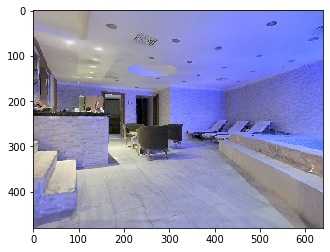

GOAL (DIST, ANG):  [3.96023851 0.14378402]
class observation from goal chair



ostensible observation from goal tensor([3.9602, 0.1438], device='cuda:0')
estimatedGoalPos2D tensor([[237., 185.]], device='cuda:0')
action_history [2, 1]
cur_time 0.30000000000000004
steps 3
located_true_goal True
gps and compass: [-6.3096724 -3.9300075] [-0.7652884]
my gps location on obs map [200 200], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.6623e-01,  4.4484e-05, -2.5770e-01, -1.3131e-01],
        [-2.1445e-04,  1.0000e+00, -6.3145e-04,  5.7489e-03],
        [ 2.5770e-01,  6.6539e-04,  9.6622e-01,  4.6542e-01],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[0.1000, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1000, 0.0000, 0.1000],
        [0.0000, 0.0000, 0.1000, 1.1000],
        [0.0000, 0.0000, 0.0000, 1.0000]], device='cuda:0')
d_angle -0.4646926522254944
distance 0.6480244994163

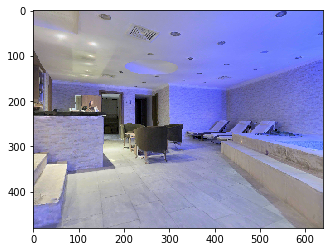

GOAL (DIST, ANG):  [3.96023851 0.40558341]
class observation from goal chair



ostensible observation from goal tensor([3.9602, 0.4056], device='cuda:0')
estimatedGoalPos2D tensor([[236., 175.]], device='cuda:0')
action_history [2, 1, 3]
cur_time 0.4
steps 4
located_true_goal True
gps and compass: [-6.3096724 -3.9300075] [-1.0270878]
my gps location on obs map [200 200], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 1.0000e+00,  1.3797e-04, -6.4368e-04, -1.2088e-01],
        [-1.3861e-04,  1.0000e+00, -9.8512e-04,  7.6635e-03],
        [ 6.4355e-04,  9.8521e-04,  1.0000e+00,  4.6799e-01],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[0.1000, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1000, 0.0000, 0.1000],
        [0.0000, 0.0000, 0.1000, 1.1000],
        [0.0000, 0.0000, 0.0000, 1.0000]], device='cuda:0')
d_angle 0
distance 0.6434639692306519




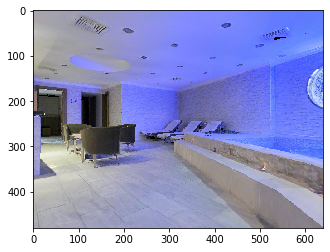

GOAL (DIST, ANG):  [3.73182486 0.43201828]
class observation from goal chair



ostensible observation from goal tensor([3.7318, 0.4320], device='cuda:0')
estimatedGoalPos2D tensor([[239., 184.]], device='cuda:0')
action_history [2, 1, 3, 1]
cur_time 0.5
steps 5
located_true_goal True
gps and compass: [-6.1803446 -3.7160587] [-1.0270878]
my gps location on obs map [200 200], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 1.0000e+00, -5.4841e-04, -2.4051e-03, -1.0806e-01],
        [ 5.4673e-04,  1.0000e+00, -6.9800e-04,  3.3917e-03],
        [ 2.4055e-03,  6.9668e-04,  1.0000e+00,  9.4873e-01],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[0.1000, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1000, 0.0000, 0.1000],
        [0.0000, 0.0000, 0.1000, 2.0000],
        [0.0000, 0.0000, 0.0000, 1.0000]], device='cuda:0')
d_angle 0
distance 1.056813359260559




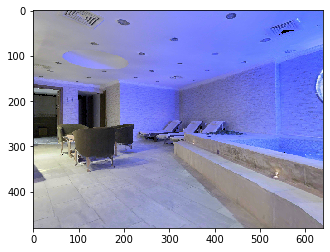

GOAL (DIST, ANG):  [3.5063566  0.46187594]
class observation from goal chair



ostensible observation from goal tensor([3.5064, 0.4619], device='cuda:0')
estimatedGoalPos2D tensor([[241., 184.]], device='cuda:0')
action_history [2, 1, 3, 1, 1]
cur_time 0.6
steps 6
located_true_goal True
gps and compass: [-6.051016  -3.5021095] [-1.0270878]
my gps location on obs map [200 200], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.9999e-01,  1.3584e-04, -3.3734e-03, -1.0246e-01],
        [-1.3961e-04,  1.0000e+00, -1.1170e-03,  1.1764e-02],
        [ 3.3732e-03,  1.1175e-03,  9.9999e-01,  1.4291e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[0.1000, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1000, 0.0000, 0.1000],
        [0.0000, 0.0000, 0.1000, 2.0000],
        [0.0000, 0.0000, 0.0000, 1.0000]], device='cuda:0')
d_angle 0
distance 0.5799741148948669




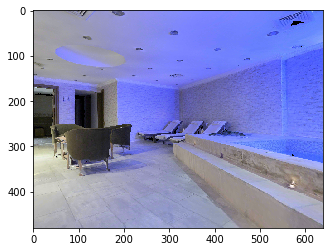

GOAL (DIST, ANG):  [3.28444215 0.49580207]
class observation from goal chair



ostensible observation from goal tensor([3.2844, 0.4958], device='cuda:0')
estimatedGoalPos2D tensor([[244., 184.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1]
cur_time 0.7
steps 7
located_true_goal True
gps and compass: [-5.9216876 -3.2881606] [-1.0270878]
my gps location on obs map [200 200], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.9999e-01,  1.3809e-04, -4.4056e-03, -9.8070e-02],
        [-1.4838e-04,  1.0000e+00, -2.3350e-03,  1.6174e-02],
        [ 4.4053e-03,  2.3357e-03,  9.9999e-01,  1.9061e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[0.1000, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1000, 0.0000, 0.1000],
        [0.0000, 0.0000, 0.1000, 3.0000],
        [0.0000, 0.0000, 0.0000, 1.0000]], device='cuda:0')
d_angle 0
distance 1.098276972770691




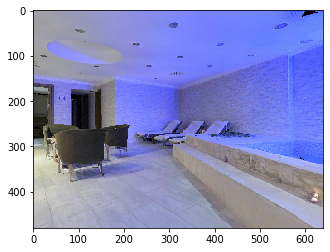

GOAL (DIST, ANG):  [3.06685189 0.53459237]
class observation from goal chair



ostensible observation from goal tensor([3.0669, 0.5346], device='cuda:0')
estimatedGoalPos2D tensor([[246., 184.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1]
cur_time 0.7999999999999999
steps 8
located_true_goal True
gps and compass: [-5.792359  -3.0742114] [-1.0270878]
my gps location on obs map [200 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.9999e-01, -3.8721e-04, -5.3927e-03, -9.0665e-02],
        [ 3.7147e-04,  1.0000e+00, -2.9195e-03,  2.0682e-02],
        [ 5.3938e-03,  2.9174e-03,  9.9998e-01,  2.3885e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[0.1000, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1000, 0.0000, 0.1000],
        [0.0000, 0.0000, 0.1000, 3.0000],
        [0.0000, 0.0000, 0.0000, 1.0000]], device='cuda:0')
d_angle 0
distance 0.6181401610374451


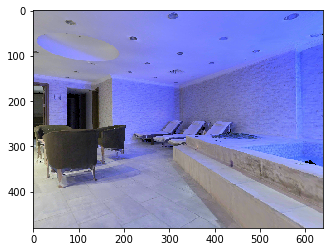

GOAL (DIST, ANG):  [2.85457644 0.57922775]
class observation from goal chair



ostensible observation from goal tensor([2.8546, 0.5792], device='cuda:0')
estimatedGoalPos2D tensor([[248., 184.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1]
cur_time 0.8999999999999999
steps 9
located_true_goal True
gps and compass: [-5.663031  -2.8602624] [-1.0270878]
my gps location on obs map [200 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.9999e-01,  1.4016e-04, -5.3526e-03, -9.0655e-02],
        [-1.5276e-04,  1.0000e+00, -2.3522e-03,  1.6938e-02],
        [ 5.3523e-03,  2.3530e-03,  9.9998e-01,  2.8658e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.4000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  3.9000],
        [ 0.0000,  0.0000,  0.0000,  1.0000]], device='cuda:0')
d_angle 0.285296618

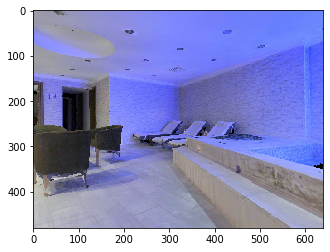

GOAL (DIST, ANG):  [2.85457644 0.31742835]
class observation from goal chair



ostensible observation from goal tensor([2.8546, 0.3174], device='cuda:0')
estimatedGoalPos2D tensor([[256., 191.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2]
cur_time 0.9999999999999999
steps 10
located_true_goal True
gps and compass: [-5.663031  -2.8602624] [-0.7652884]
my gps location on obs map [200 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.6433e-01, -1.6969e-04, -2.6469e-01, -8.6083e-02],
        [-3.4423e-04,  1.0000e+00, -1.8952e-03,  1.3054e-02],
        [ 2.6469e-01,  1.9187e-03,  9.6433e-01,  2.8637e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.4000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  3.9000],
        [ 0.0000,  0.0000,  0.0000,  1.0000]], device='cuda:0')
d_angle 0
dista

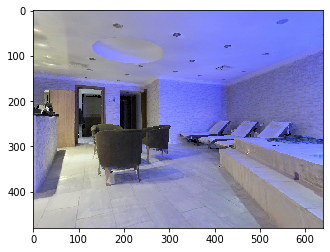

GOAL (DIST, ANG):  [2.61822888 0.34723574]
class observation from goal chair



ostensible observation from goal tensor([2.6182, 0.3472], device='cuda:0')
estimatedGoalPos2D tensor([[251., 185.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1]
cur_time 1.0999999999999999
steps 11
located_true_goal True
gps and compass: [-5.482735 -2.687076] [-0.7652884]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.6447e-01, -9.9490e-06, -2.6420e-01, -2.1753e-01],
        [-1.1211e-03,  9.9999e-01, -4.1304e-03,  2.1453e-02],
        [ 2.6419e-01,  4.2799e-03,  9.6446e-01,  3.3257e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.4000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  3.9000],
        [ 0.0000,  0.0000,  0.0000,  1.0000]], device='cuda:0')
d_angle 0
dist

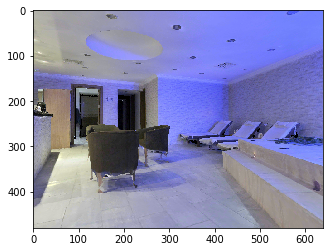

GOAL (DIST, ANG):  [2.38466783 0.38291917]
class observation from goal chair



ostensible observation from goal tensor([2.3847, 0.3829], device='cuda:0')
estimatedGoalPos2D tensor([[253., 184.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1]
cur_time 1.2
steps 12
located_true_goal True
gps and compass: [-5.3024397 -2.5138898] [-0.7652884]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.6442e-01, -6.7101e-04, -2.6437e-01, -3.4227e-01],
        [-9.4114e-04,  9.9998e-01, -5.9713e-03,  3.2849e-02],
        [ 2.6437e-01,  6.0077e-03,  9.6440e-01,  3.7984e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -1.6000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  5.3000],
        [ 0.0000,  0.0000,  0.0000,  1.0000]], device='cuda:0')
d_angle 0.42969325184822

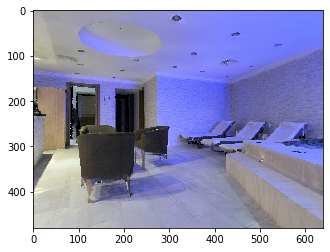

GOAL (DIST, ANG):  [2.38466783 0.12111972]
class observation from goal chair



ostensible observation from goal tensor([2.3847, 0.1211], device='cuda:0')
estimatedGoalPos2D tensor([[261., 188.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2]
cur_time 1.3
steps 13
located_true_goal True
gps and compass: [-5.3024397 -2.5138898] [-0.50348896]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6257e-01, -9.3475e-04, -5.0594e-01, -3.3437e-01],
        [-5.6849e-04,  1.0000e+00, -2.8168e-03,  2.0722e-02],
        [ 5.0594e-01,  2.7173e-03,  8.6257e-01,  3.7931e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -1.6000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  5.3000],
        [ 0.0000,  0.0000,  0.0000,  1.0000]], device='cuda:0')
d_angle 0
distance 1

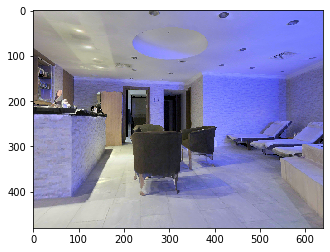

GOAL (DIST, ANG):  [2.13671293 0.13525689]
class observation from goal chair



ostensible observation from goal tensor([2.1367, 0.1353], device='cuda:0')
estimatedGoalPos2D tensor([[255., 184.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1]
cur_time 1.4000000000000001
steps 14
located_true_goal True
gps and compass: [-5.0834637 -2.3932686] [-0.50348896]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6335e-01, -3.5323e-04, -5.0461e-01, -5.7900e-01],
        [-7.0814e-04,  1.0000e+00, -1.9116e-03,  9.4598e-03],
        [ 5.0461e-01,  2.0077e-03,  8.6335e-01,  4.2045e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -1.6000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  5.3000],
        [ 0.0000,  0.0000,  0.0000,  1.0000]], device='cuda:0')
d_

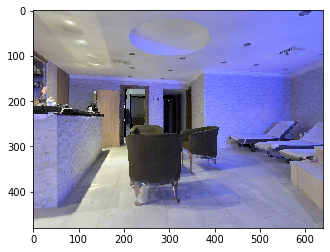

GOAL (DIST, ANG):  [1.88929674 0.15310096]
class observation from goal chair



ostensible observation from goal tensor([1.8893, 0.1531], device='cuda:0')
estimatedGoalPos2D tensor([[257., 183.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1]
cur_time 1.5000000000000002
steps 15
located_true_goal True
gps and compass: [-4.864487  -2.2726476] [-0.50348896]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6356e-01, -2.0264e-03, -5.0424e-01, -8.3065e-01],
        [-5.9018e-04,  9.9999e-01, -5.0295e-03,  2.9014e-02],
        [ 5.0424e-01,  4.6409e-03,  8.6355e-01,  4.6235e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -1.6000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  5.3000],
        [ 0.0000,  0.0000,  0.0000,  1.0000]], device='cuda:0')

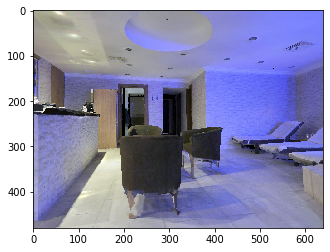

GOAL (DIST, ANG):  [1.88929674 6.17448684]
class observation from goal chair



ostensible observation from goal tensor([1.8893, 6.1745], device='cuda:0')
estimatedGoalPos2D tensor([[264., 184.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2]
cur_time 1.6000000000000003
steps 16
located_true_goal True
gps and compass: [-4.864487  -2.2726476] [-0.24168953]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.0256e-01, -1.9391e-03, -7.1162e-01, -8.2358e-01],
        [-3.5077e-04,  1.0000e+00, -3.0712e-03,  1.4263e-02],
        [ 7.1162e-01,  2.4073e-03,  7.0256e-01,  4.6325e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -1.6000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  5.3000],
        [ 0.0000,  0.0000,  0.0000,  1.0000]], device='cuda:

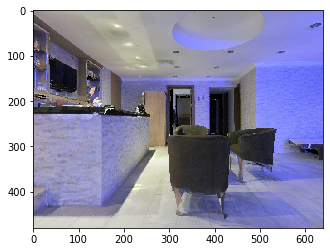

GOAL (DIST, ANG):  [1.64099657 6.15795894]
class observation from goal chair



ostensible observation from goal tensor([1.6410, 6.1580], device='cuda:0')
estimatedGoalPos2D tensor([[260., 182.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1]
cur_time 1.7000000000000004
steps 17
located_true_goal True
gps and compass: [-4.6217537 -2.2128117] [-0.24168953]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.0279e-01, -3.1815e-03, -7.1139e-01, -1.1706e+00],
        [ 5.7143e-05,  9.9999e-01, -4.4158e-03,  1.6570e-02],
        [ 7.1140e-01,  3.0627e-03,  7.0279e-01,  4.9779e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -1.6000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  5.3000],
        [ 0.0000,  0.0000,  0.0000,  1.0000]], device='cu

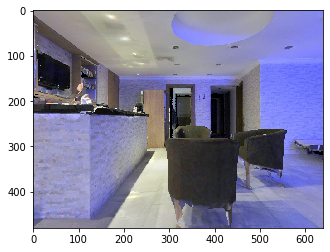

GOAL (DIST, ANG):  [1.39330392 6.13554642]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 6.1355], device='cuda:0')
estimatedGoalPos2D tensor([[261., 180.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1]
cur_time 1.8000000000000005
steps 18
located_true_goal True
gps and compass: [-4.3790197 -2.1529758] [-0.24168953]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.0251e-01, -2.7818e-03, -7.1167e-01, -1.5123e+00],
        [ 1.7436e-04,  9.9999e-01, -3.7367e-03,  1.4954e-02],
        [ 7.1167e-01,  2.5010e-03,  7.0251e-01,  5.3186e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  4.2000],
        [ 0.0000,  0.0000,  0.0000,  1.0000]], device=

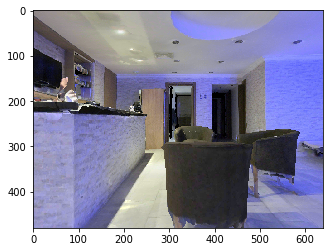

GOAL (DIST, ANG):  [1.39330392 5.87374703]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 5.8737], device='cuda:0')
estimatedGoalPos2D tensor([[267., 180.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2]
cur_time 1.9000000000000006
steps 19
located_true_goal True
gps and compass: [-4.3790197 -2.1529758] [0.02010985]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 4.9543e-01, -1.5290e-03, -8.6865e-01, -1.5169e+00],
        [-2.1387e-03,  9.9999e-01, -2.9800e-03,  1.2355e-02],
        [ 8.6865e-01,  3.3341e-03,  4.9542e-01,  5.3091e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  4.2000],
        [ 0.0000,  0.0000,  0.0000,  1.0000]], devic

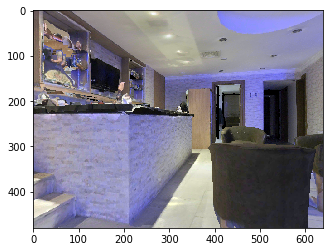

GOAL (DIST, ANG):  [1.39330392 5.61194766]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 5.6119], device='cuda:0')
estimatedGoalPos2D tensor([[267., 180.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2]
cur_time 2.0000000000000004
steps 20
located_true_goal True
gps and compass: [-4.3790197 -2.1529758] [0.28190923]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 2.5322e-01, -1.3539e-03, -9.6741e-01, -1.5196e+00],
        [-2.2516e-03,  1.0000e+00, -1.9889e-03,  1.1535e-02],
        [ 9.6741e-01,  2.6819e-03,  2.5322e-01,  5.3149e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  4.2000],
        [ 0.0000,  0.0000,  0.0000,  1.0000]], de

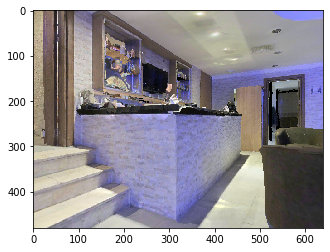

GOAL (DIST, ANG):  [1.39330392 5.35014826]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 5.3501], device='cuda:0')
estimatedGoalPos2D tensor([[267., 180.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2]
cur_time 2.1000000000000005
steps 21
located_true_goal True
gps and compass: [-4.3790197 -2.1529758] [0.5437086]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-6.3725e-03, -2.0376e-03, -9.9998e-01, -1.5203e+00],
        [-2.8435e-03,  9.9999e-01, -2.0195e-03,  1.2072e-02],
        [ 9.9998e-01,  2.8306e-03, -6.3783e-03,  5.3187e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  4.2000],
        [ 0.0000,  0.0000,  0.0000,  1.0000]], 

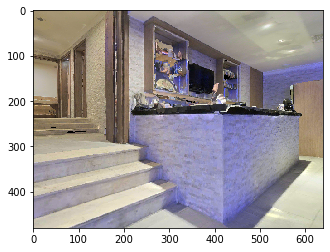

GOAL (DIST, ANG):  [1.39330392 5.08834892]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 5.0883], device='cuda:0')
estimatedGoalPos2D tensor([[267., 180.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2]
cur_time 2.2000000000000006
steps 22
located_true_goal True
gps and compass: [-4.3790197 -2.1529758] [0.80550796]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-2.6430e-01, -1.9807e-03, -9.6444e-01, -1.5221e+00],
        [-4.1866e-03,  9.9999e-01, -9.0638e-04,  1.3439e-02],
        [ 9.6443e-01,  3.7981e-03, -2.6430e-01,  5.3162e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  4.2000],
        [ 0.0000,  0.0000,  0.0000,  1.0000

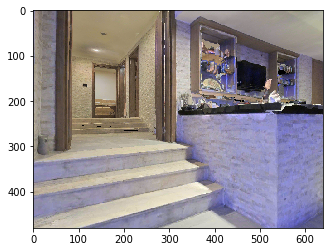

GOAL (DIST, ANG):  [1.39330392 4.82654953]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 4.8265], device='cuda:0')
estimatedGoalPos2D tensor([[267., 180.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2]
cur_time 2.3000000000000007
steps 23
located_true_goal True
gps and compass: [-4.3790197 -2.1529758] [1.0673074]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-5.0540e-01, -2.7348e-03, -8.6288e-01, -1.5258e+00],
        [-4.2233e-03,  9.9999e-01, -6.9575e-04,  1.7706e-02],
        [ 8.6287e-01,  3.2926e-03, -5.0541e-01,  5.3166e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  4.2000],
        [ 0.0000,  0.0000,  0.0000,  1.00

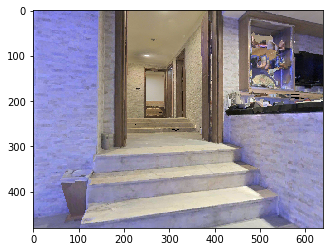

GOAL (DIST, ANG):  [1.39330392 4.56475007]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 4.5648], device='cuda:0')
estimatedGoalPos2D tensor([[267., 180.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2]
cur_time 2.400000000000001
steps 24
located_true_goal True
gps and compass: [-4.3790197 -2.1529758] [1.3291068]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.0978e-01, -7.3224e-04, -7.0443e-01, -1.5164e+00],
        [-4.1912e-03,  9.9999e-01,  3.1835e-03,  4.2474e-03],
        [ 7.0441e-01,  5.2120e-03, -7.0977e-01,  5.3059e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  4.2000],
        [ 0.0000,  0.0000,  0.0000,  1.

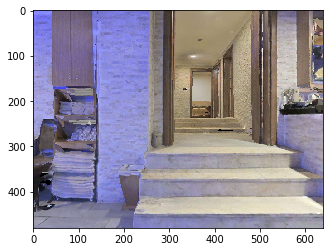

GOAL (DIST, ANG):  [1.39330392 4.30295062]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 4.3030], device='cuda:0')
estimatedGoalPos2D tensor([[266., 180.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2]
cur_time 2.500000000000001
steps 25
located_true_goal True
gps and compass: [-4.3790197 -2.1529758] [1.5909063]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.6765e-01, -9.8997e-04, -4.9718e-01, -1.5158e+00],
        [-3.4584e-03,  9.9999e-01,  4.0443e-03,  3.1488e-03],
        [ 4.9717e-01,  5.2285e-03, -8.6764e-01,  5.3062e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  4.2000],
        [ 0.0000,  0.0000,  0.0000, 

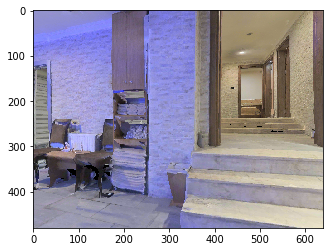

GOAL (DIST, ANG):  [1.39330392 4.04115117]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 4.0412], device='cuda:0')
estimatedGoalPos2D tensor([[267., 180.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2]
cur_time 2.600000000000001
steps 26
located_true_goal True
gps and compass: [-4.3790197 -2.1529758] [1.8527057]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-9.6743e-01,  1.1120e-03, -2.5315e-01, -1.5267e+00],
        [-4.3282e-04,  9.9998e-01,  6.0468e-03, -2.6774e-03],
        [ 2.5315e-01,  5.9594e-03, -9.6741e-01,  5.3106e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  4.2000],
        [ 0.0000,  0.0000,  0.000

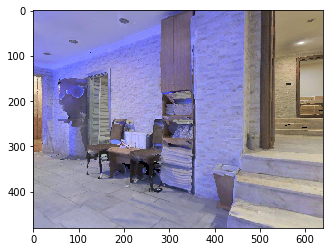

GOAL (DIST, ANG):  [1.39330392 3.77935183]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 3.7794], device='cuda:0')
estimatedGoalPos2D tensor([[267., 180.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2]
cur_time 2.700000000000001
steps 27
located_true_goal True
gps and compass: [-4.3790197 -2.1529758] [2.114505]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-1.0000e+00,  1.4747e-04,  1.9799e-03, -1.5162e+00],
        [ 1.6280e-04,  9.9997e-01,  7.7440e-03, -5.4418e-03],
        [-1.9788e-03,  7.7443e-03, -9.9997e-01,  5.2918e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  4.2000],
        [ 0.0000,  0.0000,  0.0

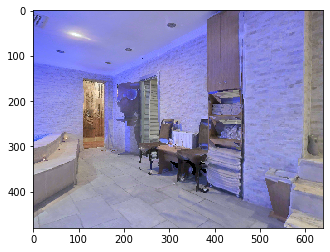

GOAL (DIST, ANG):  [1.39330392 3.51755249]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 3.5176], device='cuda:0')
estimatedGoalPos2D tensor([[266., 180.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
cur_time 2.800000000000001
steps 28
located_true_goal True
gps and compass: [-4.3790197 -2.1529758] [2.3763044]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-9.7146e-01, -3.5376e-03,  2.3719e-01, -1.4168e+00],
        [-2.3261e-03,  9.9998e-01,  5.3875e-03,  1.6220e-02],
        [-2.3720e-01,  4.6820e-03, -9.7145e-01,  5.2805e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  4.2000],
        [ 0.0000,  0.0000, 

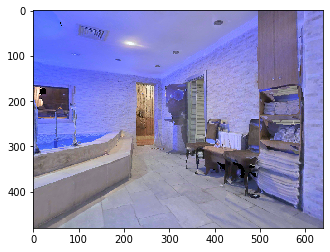

GOAL (DIST, ANG):  [1.39330392 3.25575292]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 3.2558], device='cuda:0')
estimatedGoalPos2D tensor([[266., 182.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
cur_time 2.9000000000000012
steps 29
located_true_goal True
gps and compass: [-4.3790197 -2.1529758] [2.638104]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.7567e-01, -6.8878e-04,  4.8290e-01, -1.4407e+00],
        [ 4.4959e-03,  9.9994e-01,  9.5789e-03, -6.7738e-03],
        [-4.8288e-01,  1.0559e-02, -8.7562e-01,  5.2445e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  4.2000],
        [ 0.0000,  0.000

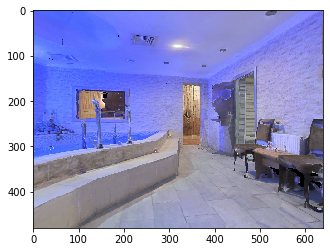

GOAL (DIST, ANG):  [1.64192397 3.23840769]
class observation from goal chair



ostensible observation from goal tensor([1.6419, 3.2384], device='cuda:0')
estimatedGoalPos2D tensor([[266., 177.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1]
cur_time 3.0000000000000013
steps 30
located_true_goal True
gps and compass: [-4.597996 -2.273597] [2.638104]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.7903e-01, -2.0486e-03,  4.7677e-01, -1.1656e+00],
        [ 2.4346e-03,  9.9996e-01,  8.7853e-03,  2.2140e-03],
        [-4.7677e-01,  8.8832e-03, -8.7899e-01,  4.8269e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  4.2000],
        [ 0.0000,  0.00

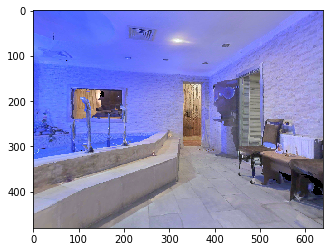

GOAL (DIST, ANG):  [1.64192397 2.97660835]
class observation from goal chair



ostensible observation from goal tensor([1.6419, 2.9766], device='cuda:0')
estimatedGoalPos2D tensor([[264., 183.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2]
cur_time 3.1000000000000014
steps 31
located_true_goal True
gps and compass: [-4.597996 -2.273597] [2.8999033]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.2704e-01, -2.0372e-03,  6.8659e-01, -1.1596e+00],
        [ 5.0758e-03,  9.9995e-01,  8.3418e-03, -1.4206e-04],
        [-6.8658e-01,  9.5498e-03, -7.2699e-01,  4.8279e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  4.2000],
        [ 0.0000,  

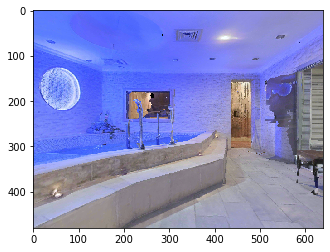

GOAL (DIST, ANG):  [1.88897518 2.99834631]
class observation from goal chair



ostensible observation from goal tensor([1.8890, 2.9983], device='cuda:0')
estimatedGoalPos2D tensor([[264., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1]
cur_time 3.2000000000000015
steps 32
located_true_goal True
gps and compass: [-4.8407297 -2.3334327] [2.8999033]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.2735e-01, -2.1102e-03,  6.8626e-01, -8.1986e-01],
        [ 5.0755e-03,  9.9995e-01,  8.4543e-03,  5.3133e-03],
        [-6.8625e-01,  9.6324e-03, -7.2731e-01,  4.4765e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.2000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  6.4000],
        [ 0.00

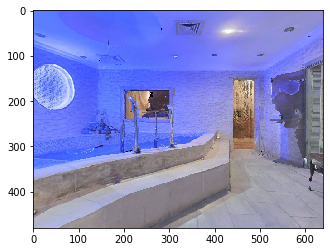

GOAL (DIST, ANG):  [1.88897518 2.73654691]
class observation from goal chair



ostensible observation from goal tensor([1.8890, 2.7365], device='cuda:0')
estimatedGoalPos2D tensor([[263., 186.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2]
cur_time 3.3000000000000016
steps 33
located_true_goal True
gps and compass: [-4.8407297 -2.3334327] [-3.1214826]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-5.2528e-01, -2.0990e-03,  8.5093e-01, -8.2413e-01],
        [ 6.8021e-03,  9.9995e-01,  6.6656e-03,  6.8190e-03],
        [-8.5090e-01,  9.2894e-03, -5.2524e-01,  4.4795e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.2000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  6.4000],
        [ 

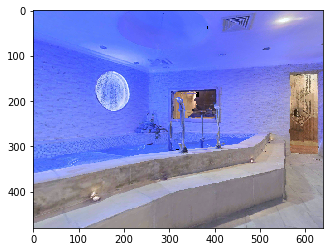

GOAL (DIST, ANG):  [1.88897518 2.47474757]
class observation from goal chair



ostensible observation from goal tensor([1.8890, 2.4747], device='cuda:0')
estimatedGoalPos2D tensor([[263., 186.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2]
cur_time 3.4000000000000017
steps 34
located_true_goal True
gps and compass: [-4.8407297 -2.3334327] [-2.8596833]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-2.8759e-01, -2.7648e-03,  9.5775e-01, -8.1616e-01],
        [ 7.5553e-03,  9.9996e-01,  5.1553e-03,  7.4988e-03],
        [-9.5772e-01,  8.7187e-03, -2.8756e-01,  4.4778e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.2000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  6.4000],
       

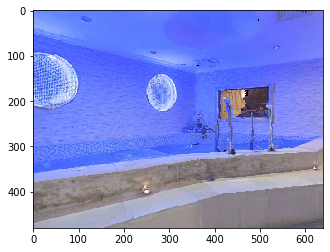

GOAL (DIST, ANG):  [1.88897518 2.21294824]
class observation from goal chair



ostensible observation from goal tensor([1.8890, 2.2129], device='cuda:0')
estimatedGoalPos2D tensor([[263., 186.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2]
cur_time 3.5000000000000018
steps 35
located_true_goal True
gps and compass: [-4.8407297 -2.3334327] [-2.597884]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-3.0091e-02, -2.3431e-03,  9.9954e-01, -8.1342e-01],
        [ 7.9857e-03,  9.9996e-01,  2.5845e-03,  9.6034e-03],
        [-9.9952e-01,  8.0598e-03, -3.0071e-02,  4.4784e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.2000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  6.4000],
     

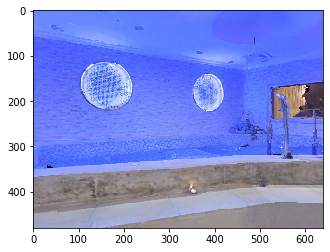

GOAL (DIST, ANG):  [1.88897518 1.95114866]
class observation from goal chair



ostensible observation from goal tensor([1.8890, 1.9511], device='cuda:0')
estimatedGoalPos2D tensor([[263., 186.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2]
cur_time 3.600000000000002
steps 36
located_true_goal True
gps and compass: [-4.8407297 -2.3334327] [-2.3360844]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 2.2986e-01, -2.9446e-03,  9.7322e-01, -8.2357e-01],
        [ 8.6777e-03,  9.9996e-01,  9.7601e-04,  2.5672e-03],
        [-9.7318e-01,  8.2209e-03,  2.2988e-01,  4.4791e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.2000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  6.4000],
  

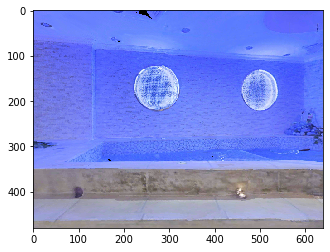

GOAL (DIST, ANG):  [1.88897518 1.68934933]
class observation from goal chair



ostensible observation from goal tensor([1.8890, 1.6893], device='cuda:0')
estimatedGoalPos2D tensor([[263., 186.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2]
cur_time 3.700000000000002
steps 37
located_true_goal True
gps and compass: [-4.8407297 -2.3334327] [-2.074285]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 4.7127e-01,  1.8195e-03,  8.8199e-01, -8.1851e-01],
        [ 5.8322e-03,  9.9997e-01, -5.1792e-03,  1.9860e-02],
        [-8.8197e-01,  7.5848e-03,  4.7124e-01,  4.4877e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.2000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  6.4000],


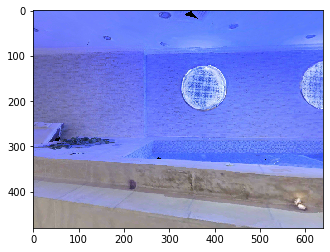

GOAL (DIST, ANG):  [1.88897518 1.42754975]
class observation from goal chair



ostensible observation from goal tensor([1.8890, 1.4275], device='cuda:0')
estimatedGoalPos2D tensor([[263., 186.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2]
cur_time 3.800000000000002
steps 38
located_true_goal True
gps and compass: [-4.8407297 -2.3334327] [-1.8124855]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 6.8669e-01,  5.5615e-03,  7.2693e-01, -8.1756e-01],
        [ 1.8928e-03,  9.9995e-01, -9.4383e-03,  2.8368e-02],
        [-7.2695e-01,  7.8571e-03,  6.8665e-01,  4.4765e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.2000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  6.400

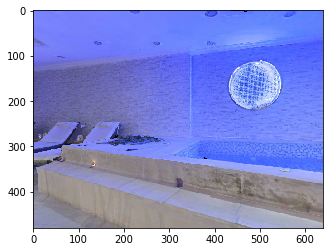

GOAL (DIST, ANG):  [1.88897518 1.1657503 ]
class observation from goal chair



ostensible observation from goal tensor([1.8890, 1.1658], device='cuda:0')
estimatedGoalPos2D tensor([[263., 186.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2]
cur_time 3.900000000000002
steps 39
located_true_goal True
gps and compass: [-4.8407297 -2.3334327] [-1.550686]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.4632e-01,  1.7595e-02,  5.3239e-01, -8.5060e-01],
        [-1.3003e-02,  9.9984e-01, -1.2373e-02,  4.6897e-02],
        [-5.3252e-01,  3.5487e-03,  8.4641e-01,  4.5013e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.2000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  6.4

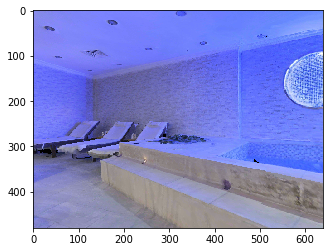

GOAL (DIST, ANG):  [1.88897518 0.90395096]
class observation from goal chair



ostensible observation from goal tensor([1.8890, 0.9040], device='cuda:0')
estimatedGoalPos2D tensor([[263., 186.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2]
cur_time 4.000000000000002
steps 40
located_true_goal True
gps and compass: [-4.8407297 -2.3334327] [-1.2888867]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.5584e-01,  6.6546e-03,  2.9381e-01, -8.3264e-01],
        [-6.9319e-03,  9.9998e-01, -9.7628e-05,  9.2124e-03],
        [-2.9380e-01, -1.9433e-03,  9.5586e-01,  4.5057e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.2000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000, 

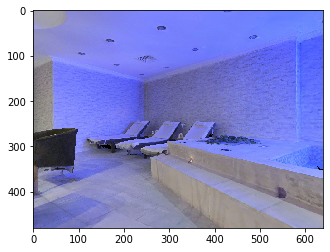

GOAL (DIST, ANG):  [1.88897518 0.64215163]
class observation from goal chair



ostensible observation from goal tensor([1.8890, 0.6422], device='cuda:0')
estimatedGoalPos2D tensor([[263., 186.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2]
cur_time 4.100000000000001
steps 41
located_true_goal True
gps and compass: [-4.8407297 -2.3334327] [-1.0270873]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.9936e-01,  7.2168e-03,  3.5024e-02, -8.3210e-01],
        [-7.2534e-03,  9.9997e-01,  9.2031e-04,  9.4477e-03],
        [-3.5017e-02, -1.1738e-03,  9.9939e-01,  4.4992e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.2000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.100

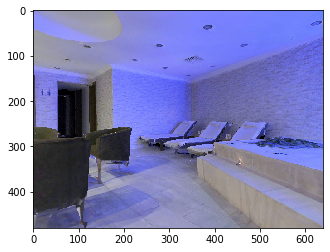

GOAL (DIST, ANG):  [1.88897518 0.38035223]
class observation from goal chair



ostensible observation from goal tensor([1.8890, 0.3804], device='cuda:0')
estimatedGoalPos2D tensor([[263., 186.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
cur_time 4.200000000000001
steps 42
located_true_goal True
gps and compass: [-4.8407297 -2.3334327] [-0.76528794]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.7485e-01,  1.1896e-02, -2.2255e-01, -8.4452e-01],
        [-1.0824e-02,  9.9992e-01,  6.0350e-03,  1.0320e-03],
        [ 2.2260e-01, -3.4744e-03,  9.7490e-01,  4.5091e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.2000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0

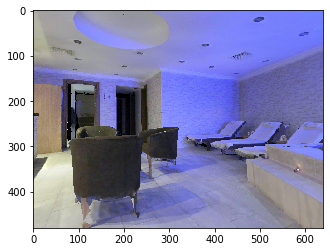

GOAL (DIST, ANG):  [1.88897518 0.11855284]
class observation from goal chair



ostensible observation from goal tensor([1.8890, 0.1186], device='cuda:0')
estimatedGoalPos2D tensor([[263., 186.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2]
cur_time 4.300000000000001
steps 43
located_true_goal True
gps and compass: [-4.8407297 -2.3334327] [-0.50348854]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6270e-01, -1.7962e-03, -5.0571e-01, -9.2567e-01],
        [ 2.4424e-04,  1.0000e+00, -3.1351e-03,  1.3909e-02],
        [ 5.0571e-01,  2.5811e-03,  8.6270e-01,  4.5544e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.2000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,

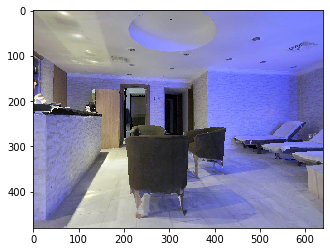

GOAL (DIST, ANG):  [1.64099657 0.13657264]
class observation from goal chair



ostensible observation from goal tensor([1.6410, 0.1366], device='cuda:0')
estimatedGoalPos2D tensor([[259., 181.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1]
cur_time 4.4
steps 44
located_true_goal True
gps and compass: [-4.6217537 -2.2128117] [-0.50348854]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6310e-01, -3.2017e-03, -5.0502e-01, -1.1725e+00],
        [ 1.6454e-03,  9.9999e-01, -3.5277e-03,  1.4236e-02],
        [ 5.0503e-01,  2.2138e-03,  8.6310e-01,  4.9785e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.2000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000,  

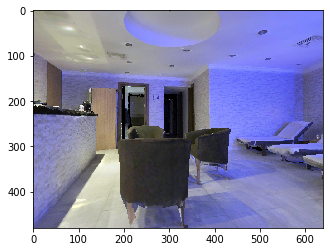

GOAL (DIST, ANG):  [1.39374031 0.1609965 ]
class observation from goal chair



ostensible observation from goal tensor([1.3937, 0.1610], device='cuda:0')
estimatedGoalPos2D tensor([[261., 180.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1]
cur_time 4.5
steps 45
located_true_goal True
gps and compass: [-4.4027777 -2.0921907] [-0.50348854]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6324e-01, -2.0109e-03, -5.0478e-01, -1.4183e+00],
        [ 5.1273e-04,  1.0000e+00, -3.1069e-03,  1.2167e-02],
        [ 5.0479e-01,  2.4232e-03,  8.6324e-01,  5.3932e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.2000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1000

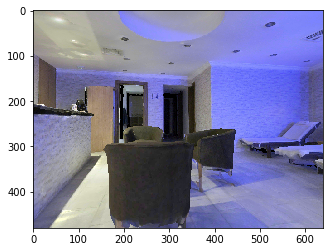

GOAL (DIST, ANG):  [1.14767289 0.19592245]
class observation from goal chair



ostensible observation from goal tensor([1.1477, 0.1959], device='cuda:0')
estimatedGoalPos2D tensor([[263., 179.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1]
cur_time 4.6
steps 46
located_true_goal True
gps and compass: [-4.183801  -1.9715697] [-0.50348854]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6336e-01, -2.1753e-03, -5.0459e-01, -1.6652e+00],
        [ 7.5995e-05,  9.9999e-01, -4.1810e-03,  2.0660e-02],
        [ 5.0459e-01,  3.5714e-03,  8.6335e-01,  5.8092e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.2000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.0000,  0.0000,  0.1

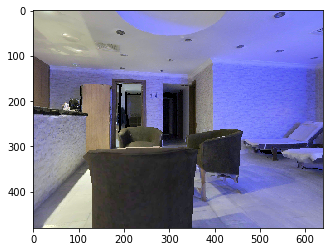

GOAL (DIST, ANG):  [0.90376723 0.24979862]
class observation from goal chair



ostensible observation from goal tensor([0.9038, 0.2498], device='cuda:0')
estimatedGoalPos2D tensor([[265., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1]
cur_time 4.699999999999999
steps 47
located_true_goal True
gps and compass: [-3.9648252 -1.8509486] [-0.50348854]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6332e-01, -1.4052e-03, -5.0465e-01, -1.9046e+00],
        [-7.1216e-04,  9.9999e-01, -4.0028e-03,  1.8755e-02],
        [ 5.0465e-01,  3.8151e-03,  8.6332e-01,  6.2136e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0.00

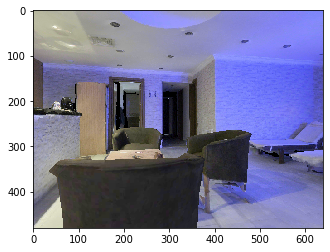

GOAL (DIST, ANG):  [0.90376723 0.51159802]
class observation from goal chair



ostensible observation from goal tensor([0.9038, 0.5116], device='cuda:0')
estimatedGoalPos2D tensor([[267., 174.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3]
cur_time 4.799999999999999
steps 48
located_true_goal True
gps and compass: [-3.9648252 -1.8509486] [-0.76528794]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.6414e-01, -2.7890e-03, -2.6539e-01, -1.8924e+00],
        [ 2.1339e-03,  9.9999e-01, -2.7566e-03,  6.2020e-03],
        [ 2.6539e-01,  2.0914e-03,  9.6414e-01,  6.2078e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [ 0

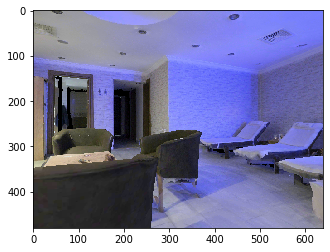

GOAL (DIST, ANG):  [0.90376723 0.77339741]
class observation from goal chair



ostensible observation from goal tensor([0.9038, 0.7734], device='cuda:0')
estimatedGoalPos2D tensor([[267., 174.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3]
cur_time 4.899999999999999
steps 49
located_true_goal True
gps and compass: [-3.9648252 -1.8509486] [-1.0270873]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.9997e-01, -2.3741e-03, -7.4735e-03, -1.8930e+00],
        [ 2.3584e-03,  9.9999e-01, -2.1069e-03,  6.9752e-03],
        [ 7.4784e-03,  2.0892e-03,  9.9997e-01,  6.2149e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
        [

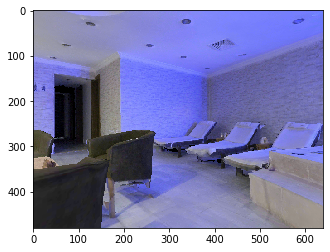

GOAL (DIST, ANG):  [0.90376723 1.03519699]
class observation from goal chair



ostensible observation from goal tensor([0.9038, 1.0352], device='cuda:0')
estimatedGoalPos2D tensor([[267., 174.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3]
cur_time 4.999999999999998
steps 50
located_true_goal True
gps and compass: [-3.9648252 -1.8509486] [-1.2888869]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.6768e-01, -1.9420e-03,  2.5217e-01, -1.9002e+00],
        [ 2.1700e-03,  1.0000e+00, -6.2625e-04,  2.3888e-03],
        [-2.5216e-01,  1.1532e-03,  9.6768e-01,  6.2163e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
      

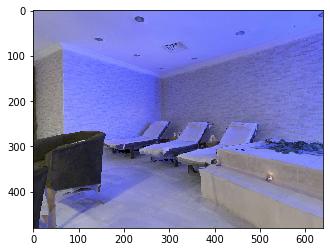

GOAL (DIST, ANG):  [0.90376723 1.29699644]
class observation from goal chair



ostensible observation from goal tensor([0.9038, 1.2970], device='cuda:0')
estimatedGoalPos2D tensor([[267., 174.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3]
cur_time 5.099999999999998
steps 51
located_true_goal True
gps and compass: [-3.9648252 -1.8509486] [-1.5506864]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6913e-01, -1.7587e-03,  4.9458e-01, -1.9089e+00],
        [ 1.9700e-03,  1.0000e+00,  9.4031e-05, -4.6735e-04],
        [-4.9458e-01,  8.9261e-04,  8.6913e-01,  6.2133e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],
   

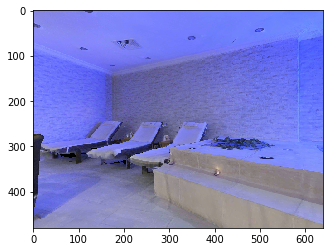

GOAL (DIST, ANG):  [0.90376723 1.55879589]
class observation from goal chair



ostensible observation from goal tensor([0.9038, 1.5588], device='cuda:0')
estimatedGoalPos2D tensor([[267., 174.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3]
cur_time 5.1999999999999975
steps 52
located_true_goal True
gps and compass: [-3.9648252 -1.8509486] [-1.8124858]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.1206e-01, -9.9253e-04,  7.0212e-01, -1.9074e+00],
        [ 1.1200e-03,  1.0000e+00,  2.7777e-04, -6.7902e-04],
        [-7.0212e-01,  5.8857e-04,  7.1206e-01,  6.2152e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000],

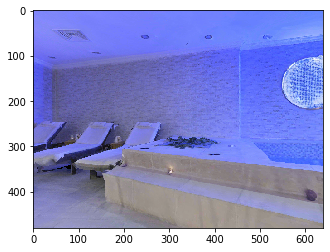

GOAL (DIST, ANG):  [0.90376723 1.82059535]
class observation from goal chair



ostensible observation from goal tensor([0.9038, 1.8206], device='cuda:0')
estimatedGoalPos2D tensor([[267., 174.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3]
cur_time 5.299999999999997
steps 53
located_true_goal True
gps and compass: [-3.9648252 -1.8509486] [-2.0742853]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 5.0413e-01, -1.4782e-03,  8.6363e-01, -1.9287e+00],
        [-2.3678e-04,  1.0000e+00,  1.8498e-03, -1.0392e-02],
        [-8.6363e-01, -1.1370e-03,  5.0413e-01,  6.2066e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1000

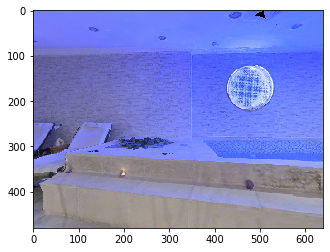

GOAL (DIST, ANG):  [0.90376723 2.08239468]
class observation from goal chair



ostensible observation from goal tensor([0.9038, 2.0824], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3]
cur_time 5.399999999999997
steps 54
located_true_goal True
gps and compass: [-3.9648252 -1.8509486] [-2.3360846]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 2.6524e-01, -3.0173e-03,  9.6418e-01, -1.9265e+00],
        [ 1.0846e-03,  1.0000e+00,  2.8310e-03, -1.0047e-02],
        [-9.6418e-01,  2.9486e-04,  2.6525e-01,  6.2012e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  0.1

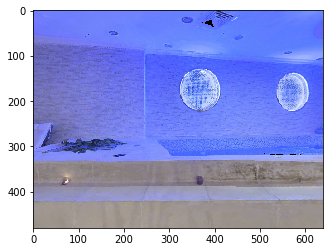

GOAL (DIST, ANG):  [0.90376723 2.34419402]
class observation from goal chair



ostensible observation from goal tensor([0.9038, 2.3442], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 5.4999999999999964
steps 55
located_true_goal True
gps and compass: [-3.9648252 -1.8509486] [-2.597884]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.1353e-03, -2.0126e-03,  9.9997e-01, -1.9204e+00],
        [ 2.6863e-03,  9.9999e-01,  1.9934e-03,  1.1205e-03],
        [-9.9997e-01,  2.6720e-03,  7.1407e-03,  6.2072e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000,  

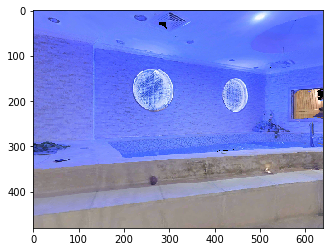

GOAL (DIST, ANG):  [0.90376723 2.60599336]
class observation from goal chair



ostensible observation from goal tensor([0.9038, 2.6060], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 5.599999999999996
steps 56
located_true_goal True
gps and compass: [-3.9648252 -1.8509486] [-2.8596833]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-2.5069e-01, -1.8581e-03,  9.6807e-01, -1.9232e+00],
        [ 3.0917e-03,  9.9999e-01,  2.7200e-03, -1.0041e-03],
        [-9.6806e-01,  3.6748e-03, -2.5068e-01,  6.2022e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0000

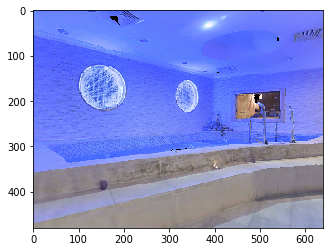

GOAL (DIST, ANG):  [0.90376723 2.86779269]
class observation from goal chair



ostensible observation from goal tensor([0.9038, 2.8678], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 5.699999999999996
steps 57
located_true_goal True
gps and compass: [-3.9648252 -1.8509486] [-3.1214826]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-4.9274e-01, -1.7644e-05,  8.7018e-01, -1.9301e+00],
        [ 3.2339e-03,  9.9999e-01,  1.8514e-03,  3.9939e-03],
        [-8.7017e-01,  3.7263e-03, -4.9273e-01,  6.2038e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0.0

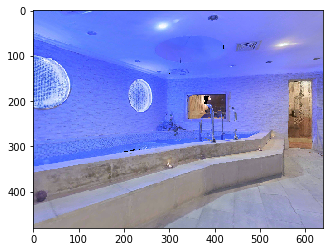

GOAL (DIST, ANG):  [0.90376723 3.12959209]
class observation from goal chair



ostensible observation from goal tensor([0.9038, 3.1296], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 5.799999999999995
steps 58
located_true_goal True
gps and compass: [-3.9648252 -1.8509486] [2.8999033]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.0187e-01,  6.0193e-04,  7.1231e-01, -1.9297e+00],
        [ 2.9210e-03,  9.9999e-01,  2.0331e-03,  8.2928e-03],
        [-7.1230e-01,  3.5076e-03, -7.0187e-01,  6.2102e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,  0

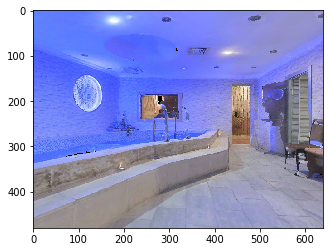

GOAL (DIST, ANG):  [1.15375335 3.13219232]
class observation from goal chair



ostensible observation from goal tensor([1.1538, 3.1322], device='cuda:0')
estimatedGoalPos2D tensor([[271., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
cur_time 5.899999999999995
steps 59
located_true_goal True
gps and compass: [-4.207559  -1.9107845] [2.8999033]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.0171e-01, -9.2612e-05,  7.1246e-01, -1.5836e+00],
        [ 2.8445e-03,  9.9999e-01,  2.9316e-03,  3.3229e-03],
        [-7.1245e-01,  4.0838e-03, -7.0171e-01,  5.8725e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.1000,

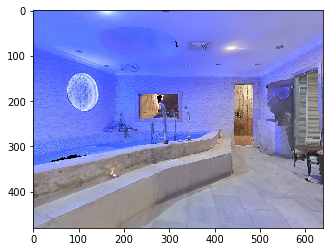

GOAL (DIST, ANG):  [1.403744   3.13386641]
class observation from goal chair



ostensible observation from goal tensor([1.4037, 3.1339], device='cuda:0')
estimatedGoalPos2D tensor([[269., 175.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1]
cur_time 5.999999999999995
steps 60
located_true_goal True
gps and compass: [-4.4502926 -1.9706203] [2.8999033]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.0128e-01, -8.8034e-05,  7.1288e-01, -1.2420e+00],
        [ 2.0578e-03,  1.0000e+00,  2.1479e-03,  1.1868e-02],
        [-7.1288e-01,  2.9733e-03, -7.0128e-01,  5.5320e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0.10

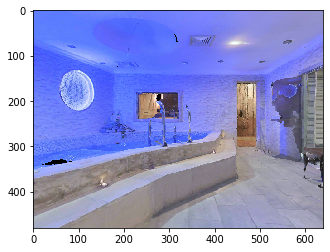

GOAL (DIST, ANG):  [1.403744   3.39566598]
class observation from goal chair



ostensible observation from goal tensor([1.4037, 3.3957], device='cuda:0')
estimatedGoalPos2D tensor([[263., 176.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3]
cur_time 6.099999999999994
steps 61
located_true_goal True
gps and compass: [-4.4502926 -1.9706203] [2.6381037]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.6181e-01,  3.0710e-04,  5.0723e-01, -1.2468e+00],
        [ 2.4495e-03,  9.9999e-01,  3.5564e-03,  3.4673e-03],
        [-5.0722e-01,  4.3074e-03, -8.6180e-01,  5.5357e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,  0

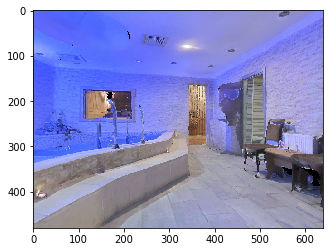

GOAL (DIST, ANG):  [1.64691724 3.35750231]
class observation from goal chair



ostensible observation from goal tensor([1.6469, 3.3575], device='cuda:0')
estimatedGoalPos2D tensor([[268., 177.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1]
cur_time 6.199999999999994
steps 62
located_true_goal True
gps and compass: [-4.6692686 -2.0912414] [2.6381037]
my gps location on obs map [210 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.6185e-01, -1.0762e-03,  5.0716e-01, -9.9787e-01],
        [ 1.1885e-03,  9.9999e-01,  4.1416e-03,  1.6382e-03],
        [-5.0716e-01,  4.1722e-03, -8.6184e-01,  5.1195e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.0000,

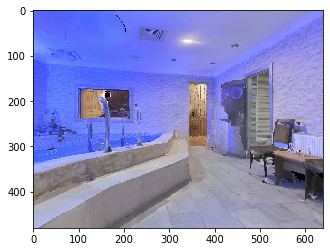

GOAL (DIST, ANG):  [1.89187084 3.3291885 ]
class observation from goal chair



ostensible observation from goal tensor([1.8919, 3.3292], device='cuda:0')
estimatedGoalPos2D tensor([[266., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1]
cur_time 6.299999999999994
steps 63
located_true_goal True
gps and compass: [-4.8882446 -2.2118623] [2.6381037]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.6187e-01, -6.1445e-05,  5.0713e-01, -7.4931e-01],
        [ 1.7657e-03,  9.9999e-01,  3.1220e-03,  1.1644e-02],
        [-5.0713e-01,  3.5862e-03, -8.6186e-01,  4.6995e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -0.5000],
        [ 0.00

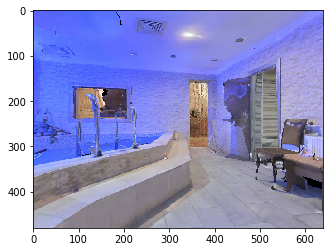

GOAL (DIST, ANG):  [2.13799344 3.30737936]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 3.3074], device='cuda:0')
estimatedGoalPos2D tensor([[264., 179.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1]
cur_time 6.399999999999993
steps 64
located_true_goal True
gps and compass: [-5.107221  -2.3324833] [2.6381037]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.6177e-01, -1.4520e-03,  5.0729e-01, -5.1106e-01],
        [ 1.0688e-03,  9.9999e-01,  4.6779e-03,  5.9195e-03],
        [-5.0729e-01,  4.5735e-03, -8.6176e-01,  4.2882e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.1000],
        [ 0

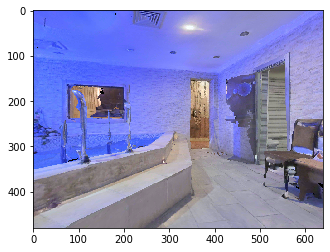

GOAL (DIST, ANG):  [2.13799344 3.56917869]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 3.5692], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3]
cur_time 6.499999999999993
steps 65
located_true_goal True
gps and compass: [-5.107221  -2.3324833] [2.3763044]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-9.6354e-01, -8.5506e-04,  2.6757e-01, -5.0922e-01],
        [ 2.2480e-04,  9.9999e-01,  4.0052e-03,  1.1205e-02],
        [-2.6757e-01,  3.9193e-03, -9.6353e-01,  4.2853e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.1000],
        

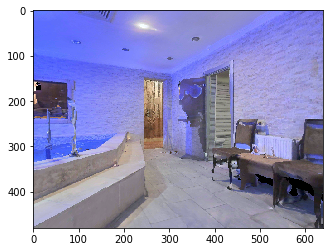

GOAL (DIST, ANG):  [2.13799344 3.83097803]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 3.8310], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3]
cur_time 6.5999999999999925
steps 66
located_true_goal True
gps and compass: [-5.107221  -2.3324833] [2.114505]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-9.9996e-01, -6.7119e-04,  8.7960e-03, -5.0887e-01],
        [-6.4154e-04,  9.9999e-01,  3.3732e-03,  1.3698e-02],
        [-8.7982e-03,  3.3674e-03, -9.9996e-01,  4.2890e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.1000],
     

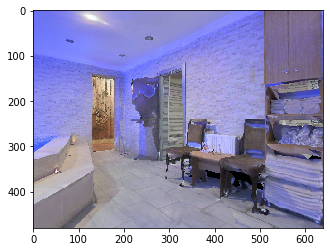

GOAL (DIST, ANG):  [2.13799344 4.0927776 ]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 4.0928], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3]
cur_time 6.699999999999992
steps 67
located_true_goal True
gps and compass: [-5.107221  -2.3324833] [1.8527055]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-9.6796e-01, -8.5467e-04, -2.5109e-01, -5.0176e-01],
        [-1.9932e-03,  9.9999e-01,  4.2803e-03,  6.1781e-03],
        [ 2.5108e-01,  4.6437e-03, -9.6796e-01,  4.2980e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.1000],
  

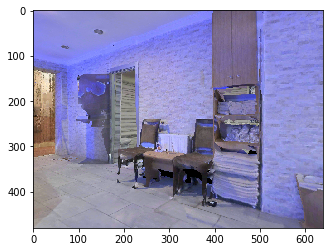

GOAL (DIST, ANG):  [2.13799344 4.35457694]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 4.3546], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3]
cur_time 6.799999999999992
steps 68
located_true_goal True
gps and compass: [-5.107221  -2.3324833] [1.5909061]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.7021e-01, -1.1924e-03, -4.9267e-01, -5.0610e-01],
        [-2.4734e-03,  1.0000e+00,  1.9485e-03,  1.5691e-02],
        [ 4.9267e-01,  2.9142e-03, -8.7021e-01,  4.2981e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.1000],

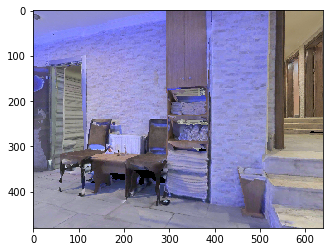

GOAL (DIST, ANG):  [2.13799344 4.61637639]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 4.6164], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3]
cur_time 6.8999999999999915
steps 69
located_true_goal True
gps and compass: [-5.107221  -2.3324833] [1.3291067]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.1149e-01, -9.9519e-04, -7.0270e-01, -4.9057e-01],
        [-4.2493e-03,  9.9999e-01,  2.8862e-03,  6.7153e-03],
        [ 7.0268e-01,  5.0395e-03, -7.1148e-01,  4.3060e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.10

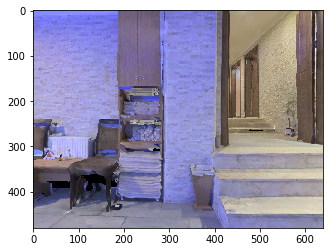

GOAL (DIST, ANG):  [2.13799344 4.87817573]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 4.8782], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3]
cur_time 6.999999999999991
steps 70
located_true_goal True
gps and compass: [-5.107221  -2.3324833] [1.0673074]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-5.0539e-01, -1.4680e-03, -8.6289e-01, -4.9587e-01],
        [-3.4689e-03,  9.9999e-01,  3.3048e-04,  1.4745e-02],
        [ 8.6288e-01,  3.1603e-03, -5.0540e-01,  4.2970e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000, -2.

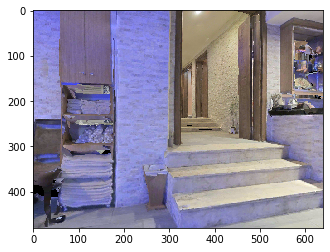

GOAL (DIST, ANG):  [2.13799344 5.13997512]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 5.1400], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3]
cur_time 7.099999999999991
steps 71
located_true_goal True
gps and compass: [-5.107221  -2.3324833] [0.80550796]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-2.6405e-01,  6.6499e-04, -9.6451e-01, -4.8807e-01],
        [-4.5170e-03,  9.9999e-01,  1.9260e-03,  2.5770e-03],
        [ 9.6450e-01,  4.8652e-03, -2.6404e-01,  4.2984e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.0000,

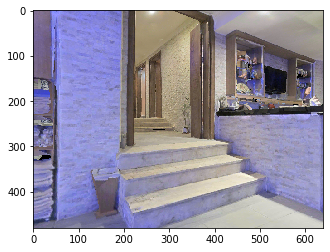

GOAL (DIST, ANG):  [2.13799344 5.40177452]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 5.4018], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 7.19999999999999
steps 72
located_true_goal True
gps and compass: [-5.107221  -2.3324833] [0.54370856]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-5.6978e-03, -2.3467e-03, -9.9998e-01, -4.8693e-01],
        [-2.9551e-03,  9.9999e-01, -2.3299e-03,  1.5979e-02],
        [ 9.9998e-01,  2.9418e-03, -5.7048e-03,  4.3032e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.000

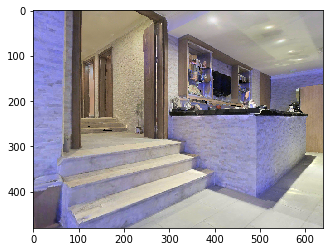

GOAL (DIST, ANG):  [2.13799344 5.66357391]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 5.6636], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 7.29999999999999
steps 73
located_true_goal True
gps and compass: [-5.107221  -2.3324833] [0.28190917]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 2.5240e-01, -2.2077e-03, -9.6762e-01, -4.8169e-01],
        [-1.0341e-03,  1.0000e+00, -2.5513e-03,  1.3760e-02],
        [ 9.6762e-01,  1.6445e-03,  2.5239e-01,  4.3075e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000,  0.

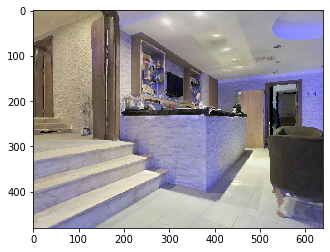

GOAL (DIST, ANG):  [2.13799344 5.92537332]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 5.9254], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 7.39999999999999
steps 74
located_true_goal True
gps and compass: [-5.107221  -2.3324833] [0.02010976]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 4.9444e-01, -1.6801e-03, -8.6921e-01, -4.8299e-01],
        [-2.3463e-04,  1.0000e+00, -2.0664e-03,  9.5531e-03],
        [ 8.6921e-01,  1.2257e-03,  4.9444e-01,  4.3061e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0000, 

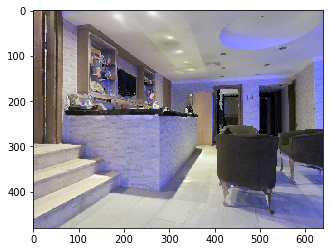

GOAL (DIST, ANG):  [2.13799344 6.18717272]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 6.1872], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 7.499999999999989
steps 75
located_true_goal True
gps and compass: [-5.107221  -2.3324833] [-0.24168964]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.0320e-01, -4.2941e-04, -7.1100e-01, -4.9269e-01],
        [-3.7511e-04,  1.0000e+00, -9.7495e-04,  5.7741e-03],
        [ 7.1100e-01,  9.5228e-04,  7.0320e-01,  4.3024e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  0.0

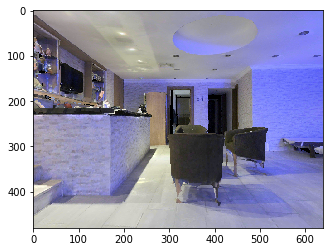

GOAL (DIST, ANG):  [1.88929674 6.17448694]
class observation from goal chair



ostensible observation from goal tensor([1.8893, 6.1745], device='cuda:0')
estimatedGoalPos2D tensor([[258., 184.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
cur_time 7.599999999999989
steps 76
located_true_goal True
gps and compass: [-4.864487  -2.2726476] [-0.24168964]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.0228e-01, -2.0665e-03, -7.1190e-01, -8.2700e-01],
        [ 5.4166e-04,  1.0000e+00, -2.3685e-03,  1.0672e-02],
        [ 7.1190e-01,  1.2778e-03,  7.0228e-01,  4.6471e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000,  

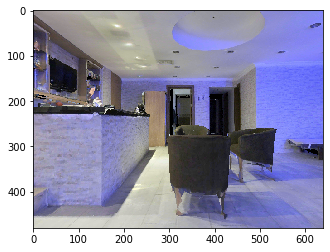

GOAL (DIST, ANG):  [1.64099657 6.15795905]
class observation from goal chair



ostensible observation from goal tensor([1.6410, 6.1580], device='cuda:0')
estimatedGoalPos2D tensor([[260., 182.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1]
cur_time 7.699999999999989
steps 77
located_true_goal True
gps and compass: [-4.6217537 -2.2128117] [-0.24168964]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.0288e-01, -2.4860e-03, -7.1131e-01, -1.1760e+00],
        [ 3.3663e-04,  9.9999e-01, -3.1624e-03,  1.4131e-02],
        [ 7.1131e-01,  1.9833e-03,  7.0287e-01,  4.9849e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1000

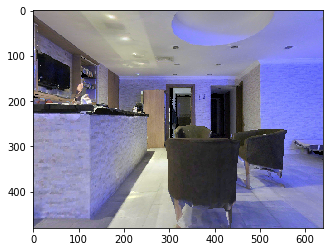

GOAL (DIST, ANG):  [1.39330392 6.13554652]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 6.1355], device='cuda:0')
estimatedGoalPos2D tensor([[261., 180.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1]
cur_time 7.799999999999988
steps 78
located_true_goal True
gps and compass: [-4.3790197 -2.1529758] [-0.24168964]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.0290e-01, -1.9053e-03, -7.1129e-01, -1.5203e+00],
        [ 4.5311e-04,  1.0000e+00, -2.2309e-03,  9.5145e-03],
        [ 7.1129e-01,  1.2458e-03,  7.0290e-01,  5.3245e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.1

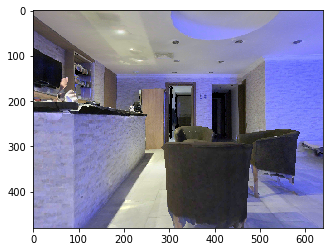

GOAL (DIST, ANG):  [1.39330392 0.11416059]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 0.1142], device='cuda:0')
estimatedGoalPos2D tensor([[262., 174.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3]
cur_time 7.899999999999988
steps 79
located_true_goal True
gps and compass: [-4.3790197 -2.1529758] [-0.503489]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6303e-01, -1.8737e-03, -5.0514e-01, -1.5175e+00],
        [ 1.1661e-03,  1.0000e+00, -1.7169e-03,  2.2814e-03],
        [ 5.0515e-01,  8.9270e-04,  8.6303e-01,  5.3164e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[ 0.

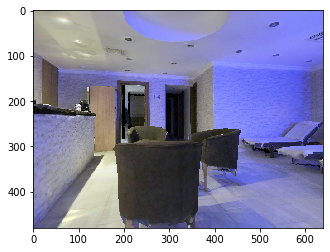

GOAL (DIST, ANG):  [1.14528542 0.13902884]
class observation from goal chair



ostensible observation from goal tensor([1.1453, 0.1390], device='cuda:0')
estimatedGoalPos2D tensor([[263., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1]
cur_time 7.999999999999988
steps 80
located_true_goal True
gps and compass: [-4.1600437 -2.0323546] [-0.503489]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6313e-01, -3.2376e-03, -5.0498e-01, -1.7638e+00],
        [ 1.2915e-03,  9.9999e-01, -4.2039e-03,  2.1522e-02],
        [ 5.0498e-01,  2.9763e-03,  8.6312e-01,  5.7345e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor([[

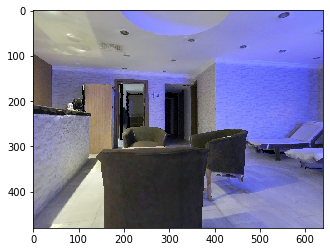

GOAL (DIST, ANG):  [0.89836607 0.17760325]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 0.1776], device='cuda:0')
estimatedGoalPos2D tensor([[265., 177.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1]
cur_time 8.099999999999987
steps 81
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-0.503489]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6265e-01, -3.0552e-03, -5.0578e-01, -2.0008e+00],
        [ 1.0902e-03,  9.9999e-01, -4.1810e-03,  1.7487e-02],
        [ 5.0579e-01,  3.0553e-03,  8.6265e-01,  6.1464e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next tensor

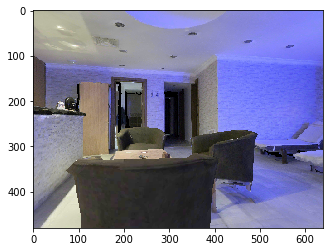

GOAL (DIST, ANG):  [0.89836607 0.4394027 ]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 0.4394], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3]
cur_time 8.199999999999987
steps 82
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-0.7652885]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.6410e-01, -2.6172e-03, -2.6553e-01, -2.0006e+00],
        [ 1.7695e-03,  9.9999e-01, -3.4314e-03,  1.7275e-02],
        [ 2.6554e-01,  2.8383e-03,  9.6410e-01,  6.1470e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next te

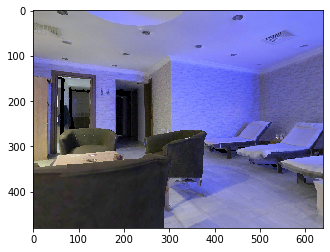

GOAL (DIST, ANG):  [0.89836607 0.70120204]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 0.7012], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3]
cur_time 8.299999999999986
steps 83
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-1.0270878]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.9997e-01, -1.9955e-03, -7.1856e-03, -1.9993e+00],
        [ 1.9769e-03,  9.9999e-01, -2.5954e-03,  1.4318e-02],
        [ 7.1907e-03,  2.5812e-03,  9.9997e-01,  6.1440e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_next

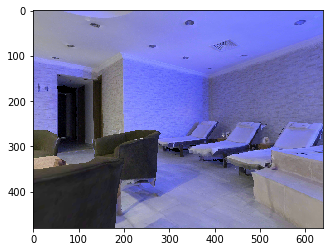

GOAL (DIST, ANG):  [0.89836607 0.96300137]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 0.9630], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3]
cur_time 8.399999999999986
steps 84
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-1.2888871]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.6779e-01, -2.2728e-03,  2.5176e-01, -1.9980e+00],
        [ 2.7218e-03,  1.0000e+00, -1.4354e-03,  1.0432e-02],
        [-2.5176e-01,  2.0744e-03,  9.6779e-01,  6.1426e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')
p_n

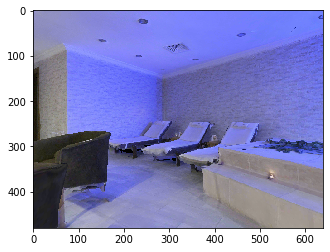

GOAL (DIST, ANG):  [0.89836607 1.22480083]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 1.2248], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3]
cur_time 8.499999999999986
steps 85
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-1.5506866]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6925e-01, -1.0408e-03,  4.9437e-01, -2.0069e+00],
        [ 1.7200e-03,  1.0000e+00, -9.1885e-04,  5.1971e-03],
        [-4.9437e-01,  1.6490e-03,  8.6925e-01,  6.1401e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0')


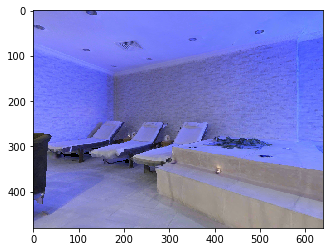

GOAL (DIST, ANG):  [0.89836607 1.48660028]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 1.4866], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3]
cur_time 8.599999999999985
steps 86
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-1.812486]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.1211e-01, -8.0705e-04,  7.0207e-01, -2.0009e+00],
        [ 2.2909e-03,  1.0000e+00, -1.1742e-03,  8.3946e-03],
        [-7.0206e-01,  2.4445e-03,  7.1211e-01,  6.1334e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cuda:0'

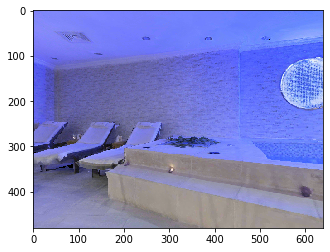

GOAL (DIST, ANG):  [0.89836607 1.74839974]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 1.7484], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3]
cur_time 8.699999999999985
steps 87
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-2.0742855]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 5.0632e-01, -1.3378e-03,  8.6234e-01, -2.0044e+00],
        [ 2.6235e-03,  1.0000e+00,  1.0974e-05,  4.7325e-03],
        [-8.6234e-01,  2.2568e-03,  5.0632e-01,  6.1309e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='cud

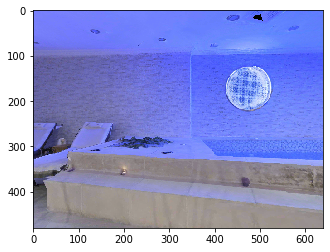

GOAL (DIST, ANG):  [0.89836607 2.01019907]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 2.0102], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3]
cur_time 8.799999999999985
steps 88
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-2.3360848]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 2.6548e-01, -6.1183e-04,  9.6412e-01, -2.0065e+00],
        [ 2.5345e-03,  1.0000e+00, -6.3309e-05,  9.2457e-03],
        [-9.6411e-01,  2.4604e-03,  2.6548e-01,  6.1339e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], device='

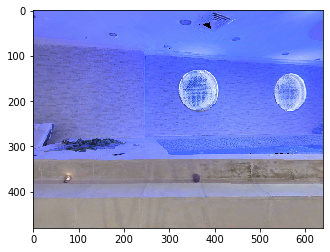

GOAL (DIST, ANG):  [0.89836607 2.27199841]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 2.2720], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 8.899999999999984
steps 89
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-2.5978842]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.1662e-03, -4.0093e-04,  9.9997e-01, -2.0144e+00],
        [ 2.7314e-03,  1.0000e+00,  3.8137e-04,  7.0599e-03],
        [-9.9997e-01,  2.7286e-03,  7.1672e-03,  6.1314e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], devic

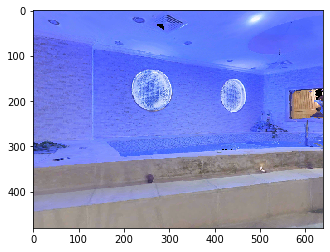

GOAL (DIST, ANG):  [0.89836607 2.53379774]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 2.5338], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 8.999999999999984
steps 90
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-2.8596835]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-2.5165e-01, -1.0512e-04,  9.6782e-01, -2.0172e+00],
        [ 3.2862e-03,  9.9999e-01,  9.6309e-04,  8.7759e-03],
        [-9.6781e-01,  3.4228e-03, -2.5165e-01,  6.1316e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], de

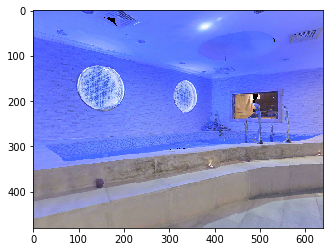

GOAL (DIST, ANG):  [0.89836607 2.79559732]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 2.7956], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 9.099999999999984
steps 91
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-3.121483]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-4.9386e-01, -6.1136e-04,  8.6954e-01, -2.0222e+00],
        [ 2.3286e-03,  1.0000e+00,  2.0256e-03,  3.6625e-03],
        [-8.6954e-01,  3.0252e-03, -4.9386e-01,  6.1344e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]], 

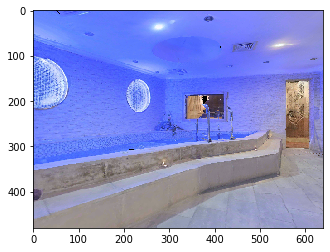

GOAL (DIST, ANG):  [0.89836607 3.05739672]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 3.0574], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 9.199999999999983
steps 92
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [2.8999028]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.0273e-01, -5.3882e-04,  7.1145e-01, -2.0217e+00],
        [ 1.7735e-03,  1.0000e+00,  2.5092e-03,  4.4290e-03],
        [-7.1145e-01,  3.0251e-03, -7.0273e-01,  6.1403e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+00]

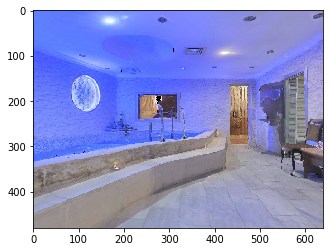

GOAL (DIST, ANG):  [1.14767282 3.0757166 ]
class observation from goal chair



ostensible observation from goal tensor([1.1477, 3.0757], device='cuda:0')
estimatedGoalPos2D tensor([[270., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
cur_time 9.299999999999983
steps 93
located_true_goal True
gps and compass: [-4.183801  -1.9715694] [2.8999028]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.0225e-01, -6.5426e-04,  7.1193e-01, -1.6829e+00],
        [ 2.0761e-03,  9.9999e-01,  2.9669e-03,  3.6504e-03],
        [-7.1193e-01,  3.5615e-03, -7.0225e-01,  5.8013e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.0000e+

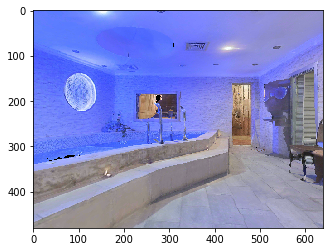

GOAL (DIST, ANG):  [1.39722818 3.08749534]
class observation from goal chair



ostensible observation from goal tensor([1.3972, 3.0875], device='cuda:0')
estimatedGoalPos2D tensor([[269., 174.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1]
cur_time 9.399999999999983
steps 94
located_true_goal True
gps and compass: [-4.4265356 -2.0314054] [2.8999028]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.0191e-01, -1.9724e-04,  7.1226e-01, -1.3388e+00],
        [ 2.6148e-03,  9.9999e-01,  2.8538e-03,  7.2218e-03],
        [-7.1226e-01,  3.8656e-03, -7.0191e-01,  5.4588e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.000

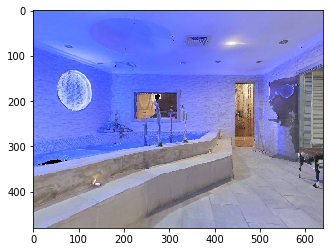

GOAL (DIST, ANG):  [1.64691762 3.09570343]
class observation from goal chair



ostensible observation from goal tensor([1.6469, 3.0957], device='cuda:0')
estimatedGoalPos2D tensor([[267., 176.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1]
cur_time 9.499999999999982
steps 95
located_true_goal True
gps and compass: [-4.669269  -2.0912411] [2.8999028]
my gps location on obs map [210 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.0240e-01, -5.8467e-04,  7.1178e-01, -9.8900e-01],
        [ 1.5845e-03,  1.0000e+00,  2.3850e-03,  1.2247e-02],
        [-7.1178e-01,  2.8031e-03, -7.0240e-01,  5.1244e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00,  1.

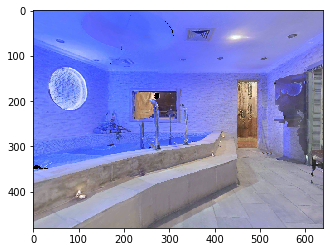

GOAL (DIST, ANG):  [1.64691762 3.35750277]
class observation from goal chair



ostensible observation from goal tensor([1.6469, 3.3575], device='cuda:0')
estimatedGoalPos2D tensor([[261., 177.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3]
cur_time 9.599999999999982
steps 96
located_true_goal True
gps and compass: [-4.669269  -2.0912411] [2.6381035]
my gps location on obs map [210 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.6232e-01, -7.5913e-04,  5.0636e-01, -9.9364e-01],
        [ 1.0203e-03,  9.9999e-01,  3.2367e-03,  7.6728e-03],
        [-5.0636e-01,  3.3077e-03, -8.6232e-01,  5.1228e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+00, 

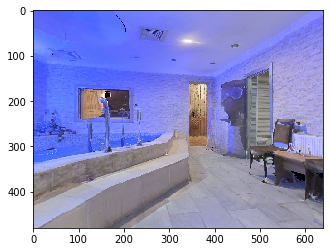

GOAL (DIST, ANG):  [1.89187175 3.3291889 ]
class observation from goal chair



ostensible observation from goal tensor([1.8919, 3.3292], device='cuda:0')
estimatedGoalPos2D tensor([[266., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1]
cur_time 9.699999999999982
steps 97
located_true_goal True
gps and compass: [-4.8882456 -2.2118623] [2.6381035]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.6220e-01, -3.8455e-04,  5.0657e-01, -7.4883e-01],
        [ 1.3743e-03,  9.9999e-01,  3.0983e-03,  9.9430e-03],
        [-5.0657e-01,  3.3675e-03, -8.6219e-01,  4.7015e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000e+0

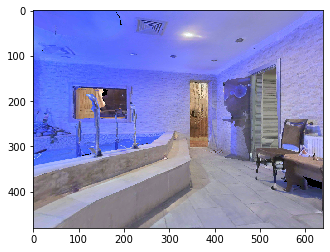

GOAL (DIST, ANG):  [2.13799397 3.30737956]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 3.3074], device='cuda:0')
estimatedGoalPos2D tensor([[264., 179.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1]
cur_time 9.799999999999981
steps 98
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [2.6381035]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.6265e-01, -1.2152e-03,  5.0580e-01, -4.9655e-01],
        [ 4.3842e-04,  9.9999e-01,  3.1503e-03,  1.4152e-02],
        [-5.0580e-01,  2.9394e-03, -8.6265e-01,  4.2856e+00],
        [ 0.0000e+00,  0.0000e+00,  0.0000

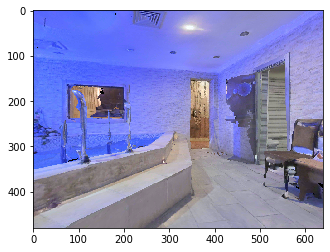

GOAL (DIST, ANG):  [2.13799397 3.5691789 ]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 3.5692], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3]
cur_time 9.89999999999998
steps 99
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [2.3763041]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-9.6395e-01, -8.5783e-04,  2.6609e-01, -5.0188e-01],
        [-6.6953e-05,  1.0000e+00,  2.9812e-03,  1.4792e-02],
        [-2.6610e-01,  2.8559e-03, -9.6394e-01,  4.2887e+00],
        [ 0.0000e+00,  0.0000e+00,  0.00

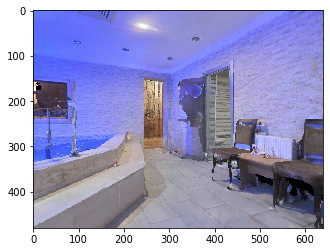

GOAL (DIST, ANG):  [2.13799397 3.83097823]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 3.8310], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3]
cur_time 9.99999999999998
steps 100
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [2.1145048]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-9.9997e-01, -1.1625e-03,  8.0260e-03, -5.0672e-01],
        [-1.1319e-03,  9.9999e-01,  3.8154e-03,  9.6609e-03],
        [-8.0304e-03,  3.8062e-03, -9.9996e-01,  4.2948e+00],
        [ 0.0000e+00,  0.0000e+00,  

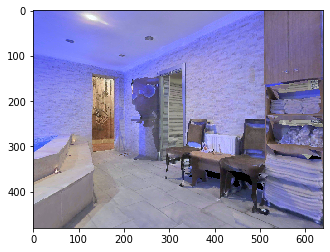

GOAL (DIST, ANG):  [2.13799397 4.09277769]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 4.0928], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3]
cur_time 10.09999999999998
steps 101
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [1.8527054]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-9.6775e-01, -1.3903e-03, -2.5190e-01, -4.9799e-01],
        [-2.4289e-03,  9.9999e-01,  3.8122e-03,  6.6231e-03],
        [ 2.5189e-01,  4.3011e-03, -9.6775e-01,  4.3030e+00],
        [ 0.0000e+00,  0.0000e+0

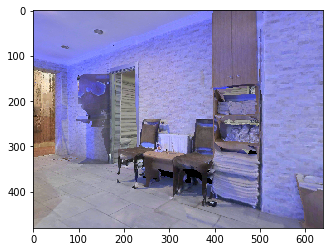

GOAL (DIST, ANG):  [2.13799397 4.35457702]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 4.3546], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3]
cur_time 10.19999999999998
steps 102
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [1.590906]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.6946e-01, -1.3285e-03, -4.9400e-01, -4.9727e-01],
        [-3.0987e-03,  9.9999e-01,  2.7645e-03,  8.3353e-03],
        [ 4.9399e-01,  3.9344e-03, -8.6946e-01,  4.3030e+00],
        [ 0.0000e+00,  0.0000e

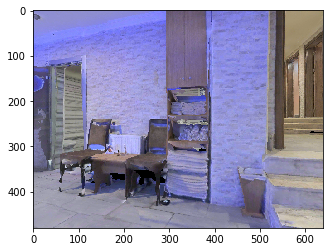

GOAL (DIST, ANG):  [2.13799397 4.61637648]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 4.6164], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3]
cur_time 10.29999999999998
steps 103
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [1.3291066]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.1172e-01, -1.2943e-03, -7.0246e-01, -4.9442e-01],
        [-3.5590e-03,  9.9999e-01,  1.7635e-03,  9.1219e-03],
        [ 7.0245e-01,  3.7552e-03, -7.1172e-01,  4.3046e+00],
        [ 0.0000e+00,  0.0

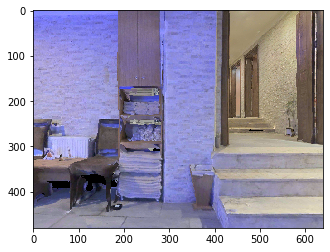

GOAL (DIST, ANG):  [2.13799397 4.87817581]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 4.8782], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3]
cur_time 10.399999999999979
steps 104
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [1.0673072]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-5.0468e-01, -1.3861e-03, -8.6331e-01, -4.8982e-01],
        [-3.3914e-03,  9.9999e-01,  3.7702e-04,  1.0336e-02],
        [ 8.6330e-01,  3.1181e-03, -5.0468e-01,  4.3011e+00],
        [ 0.0000e+00, 

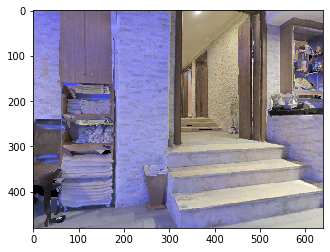

GOAL (DIST, ANG):  [2.13799397 5.13997509]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 5.1400], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3]
cur_time 10.499999999999979
steps 105
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [0.80550796]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-2.6307e-01, -1.3687e-03, -9.6478e-01, -4.8787e-01],
        [-3.5038e-03,  9.9999e-01, -4.6329e-04,  1.1115e-02],
        [ 9.6477e-01,  3.2585e-03, -2.6307e-01,  4.2968e+00],
        [ 0.0000e+

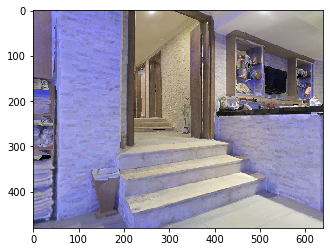

GOAL (DIST, ANG):  [2.13799397 5.40177449]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 5.4018], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 10.599999999999978
steps 106
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [0.54370856]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-5.7701e-03, -1.2143e-03, -9.9998e-01, -4.8709e-01],
        [-3.0195e-03,  9.9999e-01, -1.1968e-03,  9.6595e-03],
        [ 9.9998e-01,  3.0125e-03, -5.7738e-03,  4.3029e+00],
        [ 0.000

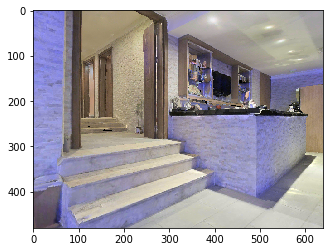

GOAL (DIST, ANG):  [2.13799397 5.66357388]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 5.6636], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 10.699999999999978
steps 107
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [0.28190917]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 2.5253e-01, -1.1452e-03, -9.6759e-01, -4.7892e-01],
        [-1.5547e-03,  1.0000e+00, -1.5894e-03,  8.3269e-03],
        [ 9.6759e-01,  1.9057e-03,  2.5253e-01,  4.3048e+00],
        [ 0.

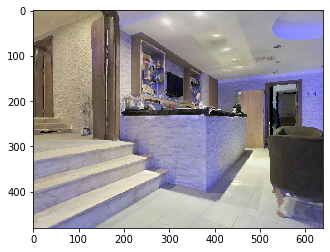

GOAL (DIST, ANG):  [2.13799397 5.92537329]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 5.9254], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 10.799999999999978
steps 108
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [0.02010976]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 4.9465e-01, -5.9165e-04, -8.6909e-01, -4.8451e-01],
        [-6.2635e-04,  1.0000e+00, -1.0372e-03,  3.3952e-03],
        [ 8.6909e-01,  1.0574e-03,  4.9464e-01,  4.3042e+00],
        [

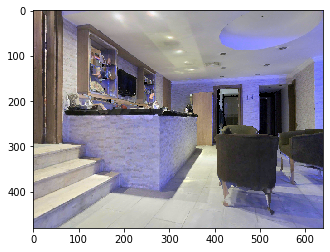

GOAL (DIST, ANG):  [2.13799397 6.18717269]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 6.1872], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 10.899999999999977
steps 109
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [-0.24168964]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.0290e-01, -1.6032e-04, -7.1129e-01, -4.9008e-01],
        [-6.0736e-04,  1.0000e+00, -8.2559e-04,  4.6461e-03],
        [ 7.1129e-01,  1.0123e-03,  7.0290e-01,  4.3030e+00],
     

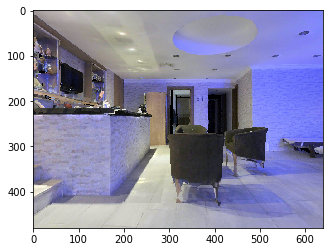

GOAL (DIST, ANG):  [1.88929719 6.17448703]
class observation from goal chair



ostensible observation from goal tensor([1.8893, 6.1745], device='cuda:0')
estimatedGoalPos2D tensor([[258., 184.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
cur_time 10.999999999999977
steps 110
located_true_goal True
gps and compass: [-4.8644876 -2.2726476] [-0.24168964]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.0276e-01, -1.2213e-03, -7.1143e-01, -8.2965e-01],
        [-2.2025e-04,  1.0000e+00, -1.9342e-03,  8.0494e-03],
        [ 7.1143e-01,  1.5160e-03,  7.0276e-01,  4.6429e+00],
  

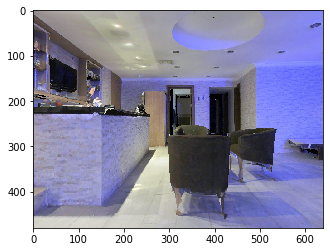

GOAL (DIST, ANG):  [1.64099657 6.15795905]
class observation from goal chair



ostensible observation from goal tensor([1.6410, 6.1580], device='cuda:0')
estimatedGoalPos2D tensor([[260., 182.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1]
cur_time 11.099999999999977
steps 111
located_true_goal True
gps and compass: [-4.6217537 -2.2128117] [-0.24168964]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.0315e-01, -2.0405e-03, -7.1104e-01, -1.1778e+00],
        [ 3.8421e-05,  1.0000e+00, -2.8317e-03,  1.2295e-02],
        [ 7.1104e-01,  1.9638e-03,  7.0315e-01,  4.9830e+00],

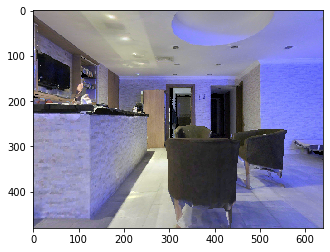

GOAL (DIST, ANG):  [1.39330392 6.13554652]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 6.1355], device='cuda:0')
estimatedGoalPos2D tensor([[261., 180.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1]
cur_time 11.199999999999976
steps 112
located_true_goal True
gps and compass: [-4.3790197 -2.1529758] [-0.24168964]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.0294e-01, -1.7732e-03, -7.1124e-01, -1.5184e+00],
        [ 1.9855e-04,  1.0000e+00, -2.2968e-03,  9.4196e-03],
        [ 7.1125e-01,  1.4733e-03,  7.0294e-01,  5.3226e+0

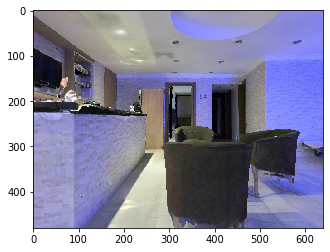

GOAL (DIST, ANG):  [1.39330392 0.11416059]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 0.1142], device='cuda:0')
estimatedGoalPos2D tensor([[262., 174.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3]
cur_time 11.299999999999976
steps 113
located_true_goal True
gps and compass: [-4.3790197 -2.1529758] [-0.503489]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6297e-01, -1.6625e-03, -5.0525e-01, -1.5151e+00],
        [ 8.0867e-04,  1.0000e+00, -1.9093e-03,  3.2725e-03],
        [ 5.0525e-01,  1.2391e-03,  8.6297e-01,  5.3155e+

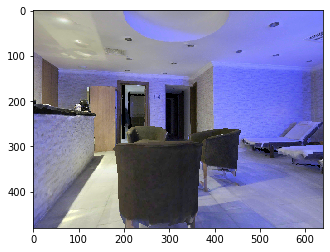

GOAL (DIST, ANG):  [1.14528542 0.13902884]
class observation from goal chair



ostensible observation from goal tensor([1.1453, 0.1390], device='cuda:0')
estimatedGoalPos2D tensor([[263., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1]
cur_time 11.399999999999975
steps 114
located_true_goal True
gps and compass: [-4.1600437 -2.0323546] [-0.503489]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6279e-01, -1.7761e-03, -5.0557e-01, -1.7563e+00],
        [ 7.3743e-04,  1.0000e+00, -2.2546e-03,  5.7002e-03],
        [ 5.0557e-01,  1.5724e-03,  8.6278e-01,  5.733

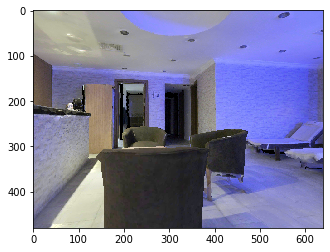

GOAL (DIST, ANG):  [0.89836607 0.17760325]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 0.1776], device='cuda:0')
estimatedGoalPos2D tensor([[265., 177.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1]
cur_time 11.499999999999975
steps 115
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-0.503489]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6263e-01, -2.0724e-03, -5.0583e-01, -1.9981e+00],
        [ 7.6418e-04,  1.0000e+00, -2.7938e-03,  1.0034e-02],
        [ 5.0584e-01,  2.0234e-03,  8.6263e-01,  6.

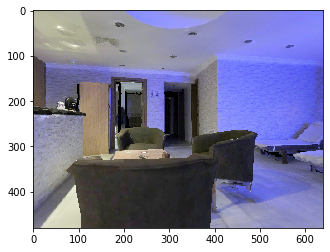

GOAL (DIST, ANG):  [0.89836607 0.4394027 ]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 0.4394], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3]
cur_time 11.599999999999975
steps 116
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-0.7652885]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.6405e-01, -2.3695e-03, -2.6572e-01, -1.9977e+00],
        [ 1.5264e-03,  9.9999e-01, -3.3795e-03,  1.5021e-02],
        [ 2.6573e-01,  2.8524e-03,  9.6404e-01,

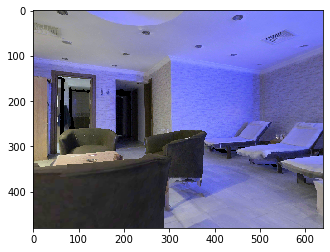

GOAL (DIST, ANG):  [0.89836607 0.70120204]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 0.7012], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3]
cur_time 11.699999999999974
steps 117
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-1.0270878]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.9998e-01, -9.9574e-04, -6.7480e-03, -1.9996e+00],
        [ 9.8031e-04,  1.0000e+00, -2.2897e-03,  1.0751e-02],
        [ 6.7503e-03,  2.2830e-03,  9.9997e-

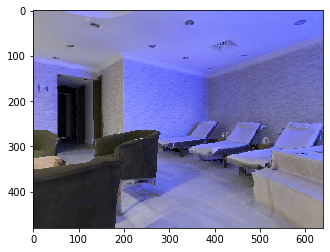

GOAL (DIST, ANG):  [0.89836607 0.96300137]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 0.9630], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3]
cur_time 11.799999999999974
steps 118
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-1.2888871]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.6780e-01, -2.3582e-03,  2.5172e-01, -1.9955e+00],
        [ 2.6582e-03,  1.0000e+00, -8.5187e-04,  3.6269e-03],
        [-2.5172e-01,  1.4936e-03,  9.678

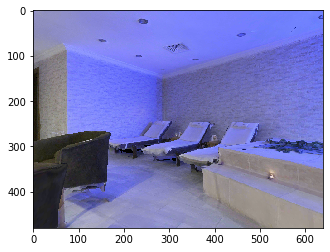

GOAL (DIST, ANG):  [0.89836607 1.22480083]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 1.2248], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3]
cur_time 11.899999999999974
steps 119
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-1.5506866]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6940e-01, -1.6650e-03,  4.9411e-01, -2.0019e+00],
        [ 2.2627e-03,  1.0000e+00, -6.1177e-04,  2.7978e-03],
        [-4.9410e-01,  1.6499e-03,  8.

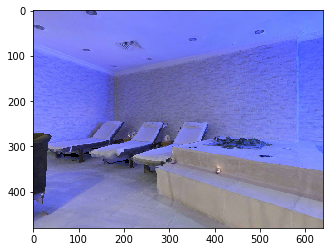

GOAL (DIST, ANG):  [0.89836607 1.48660028]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 1.4866], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3]
cur_time 11.999999999999973
steps 120
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-1.812486]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.1234e-01, -7.3338e-04,  7.0183e-01, -1.9994e+00],
        [ 2.2722e-03,  1.0000e+00, -1.2613e-03,  9.5694e-03],
        [-7.0183e-01,  2.4932e-03,  

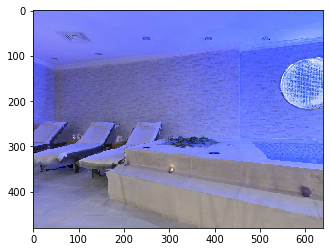

GOAL (DIST, ANG):  [0.89836607 1.74839974]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 1.7484], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3]
cur_time 12.099999999999973
steps 121
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-2.0742855]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 5.0626e-01, -9.1824e-04,  8.6238e-01, -2.0027e+00],
        [ 2.8039e-03,  1.0000e+00, -5.8128e-04,  8.1184e-03],
        [-8.6238e-01,  2.7123e-0

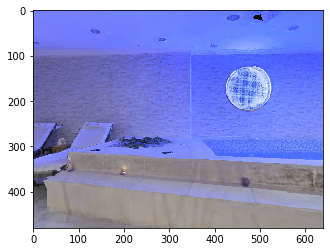

GOAL (DIST, ANG):  [0.89836607 2.01019907]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 2.0102], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3]
cur_time 12.199999999999973
steps 122
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-2.3360848]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 2.6501e-01, -4.2806e-04,  9.6425e-01, -2.0052e+00],
        [ 2.4731e-03,  1.0000e+00, -2.3578e-04,  1.0788e-02],
        [-9.6424e-01,  2.4472

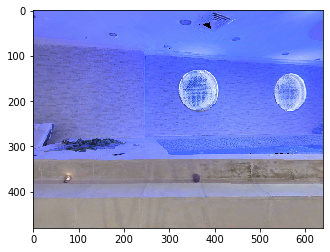

GOAL (DIST, ANG):  [0.89836607 2.27199841]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 2.2720], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 12.299999999999972
steps 123
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-2.5978842]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 6.7363e-03, -6.9175e-04,  9.9998e-01, -2.0138e+00],
        [ 2.6516e-03,  1.0000e+00,  6.7391e-04,  5.9245e-03],
        [-9.9997e-01,  2.6

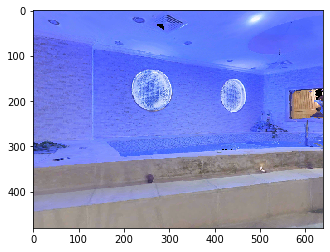

GOAL (DIST, ANG):  [0.89836607 2.53379774]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 2.5338], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 12.399999999999972
steps 124
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-2.8596835]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-2.5202e-01,  4.4725e-04,  9.6772e-01, -2.0144e+00],
        [ 3.0797e-03,  1.0000e+00,  3.3989e-04,  1.3175e-02],
        [-9.6772e-01,  

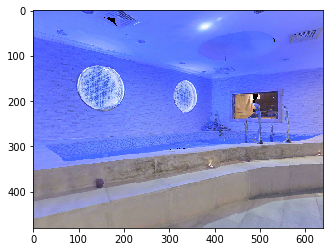

GOAL (DIST, ANG):  [0.89836607 2.79559732]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 2.7956], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 12.499999999999972
steps 125
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [-3.121483]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-4.9453e-01, -2.5460e-04,  8.6916e-01, -2.0173e+00],
        [ 2.1971e-03,  1.0000e+00,  1.5430e-03,  7.9647e-03],
        [-8.6916e-01,

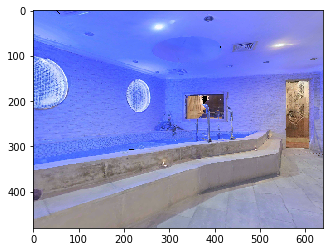

GOAL (DIST, ANG):  [0.89836607 3.05739672]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 3.0574], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 12.599999999999971
steps 126
located_true_goal True
gps and compass: [-3.9410677 -1.9117335] [2.8999028]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.0307e-01, -7.8162e-04,  7.1112e-01, -2.0218e+00],
        [ 1.7398e-03,  9.9999e-01,  2.8193e-03,  3.7244e-03],
        [-7.1112e-

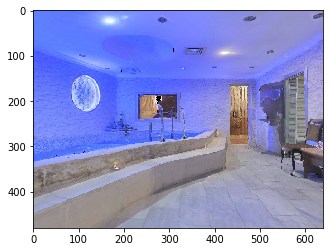

GOAL (DIST, ANG):  [1.14767331 3.07571662]
class observation from goal chair



ostensible observation from goal tensor([1.1477, 3.0757], device='cuda:0')
estimatedGoalPos2D tensor([[271., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
cur_time 12.69999999999997
steps 127
located_true_goal True
gps and compass: [-4.1838017 -1.9715695] [2.8999028]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.0237e-01, -4.3807e-04,  7.1181e-01, -1.6806e+00],
        [ 1.9952e-03,  9.9999e-01,  2.5842e-03,  7.9358e-03],
        [-7.1181

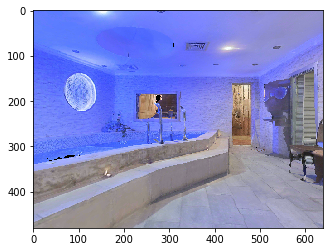

GOAL (DIST, ANG):  [1.39722818 3.08749534]
class observation from goal chair



ostensible observation from goal tensor([1.3972, 3.0875], device='cuda:0')
estimatedGoalPos2D tensor([[269., 174.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1]
cur_time 12.79999999999997
steps 128
located_true_goal True
gps and compass: [-4.4265356 -2.0314054] [2.8999028]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.0217e-01, -1.1161e-04,  7.1201e-01, -1.3380e+00],
        [ 2.3400e-03,  9.9999e-01,  2.4645e-03,  9.4304e-03],
        [-7.1

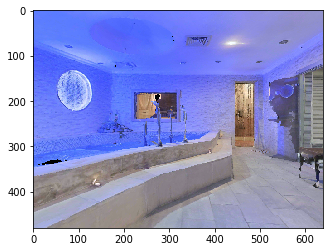

GOAL (DIST, ANG):  [1.64691762 3.09570343]
class observation from goal chair



ostensible observation from goal tensor([1.6469, 3.0957], device='cuda:0')
estimatedGoalPos2D tensor([[267., 176.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1]
cur_time 12.89999999999997
steps 129
located_true_goal True
gps and compass: [-4.669269  -2.0912411] [2.8999028]
my gps location on obs map [210 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.0235e-01, -5.9305e-04,  7.1183e-01, -9.8790e-01],
        [ 1.4431e-03,  1.0000e+00,  2.2570e-03,  1.1603e-02],
        [-

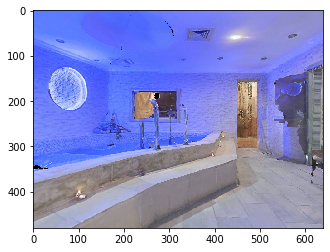

GOAL (DIST, ANG):  [1.64691762 3.35750277]
class observation from goal chair



ostensible observation from goal tensor([1.6469, 3.3575], device='cuda:0')
estimatedGoalPos2D tensor([[261., 177.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3]
cur_time 12.99999999999997
steps 130
located_true_goal True
gps and compass: [-4.669269  -2.0912411] [2.6381035]
my gps location on obs map [210 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.6235e-01, -8.5668e-04,  5.0631e-01, -9.9404e-01],
        [ 9.3886e-04,  9.9999e-01,  3.2910e-03,  7.1503e-03],
       

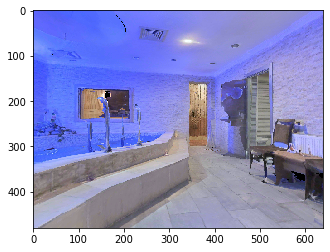

GOAL (DIST, ANG):  [1.89187175 3.3291889 ]
class observation from goal chair



ostensible observation from goal tensor([1.8919, 3.3292], device='cuda:0')
estimatedGoalPos2D tensor([[266., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1]
cur_time 13.09999999999997
steps 131
located_true_goal True
gps and compass: [-4.8882456 -2.2118623] [2.6381035]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.6222e-01, -4.4702e-04,  5.0653e-01, -7.4910e-01],
        [ 1.2858e-03,  9.9999e-01,  3.0712e-03,  9.7283e-03],
    

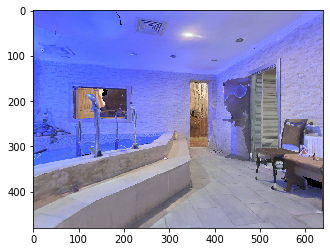

GOAL (DIST, ANG):  [2.13799397 3.30737956]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 3.3074], device='cuda:0')
estimatedGoalPos2D tensor([[264., 179.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1]
cur_time 13.199999999999969
steps 132
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [2.6381035]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.6267e-01, -1.2572e-03,  5.0577e-01, -4.9709e-01],
        [ 3.9455e-04,  9.9999e-01,  3.1587e-03,  1.4066e-02],


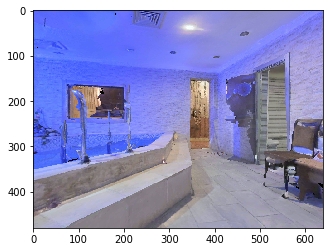

GOAL (DIST, ANG):  [2.13799397 3.5691789 ]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 3.5692], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3]
cur_time 13.299999999999969
steps 133
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [2.3763041]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-9.6394e-01, -9.8105e-04,  2.6614e-01, -5.0321e-01],
        [-1.5994e-04,  1.0000e+00,  3.1070e-03,  1.3434e-02

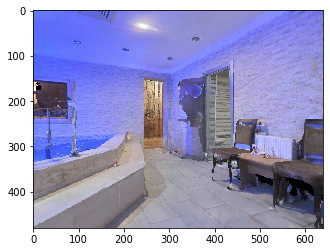

GOAL (DIST, ANG):  [2.13799397 3.83097823]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 3.8310], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3]
cur_time 13.399999999999968
steps 134
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [2.1145048]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-9.9997e-01, -1.1949e-03,  7.9342e-03, -5.0638e-01],
        [-1.1647e-03,  9.9999e-01,  3.8046e-03,  7.9569e

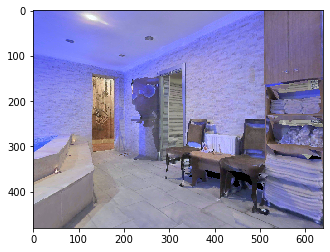

GOAL (DIST, ANG):  [2.13799397 4.09277769]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 4.0928], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3]
cur_time 13.499999999999968
steps 135
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [1.8527054]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-9.6784e-01, -1.2201e-03, -2.5156e-01, -5.0082e-01],
        [-2.2081e-03,  9.9999e-01,  3.6453e-03,  5.37

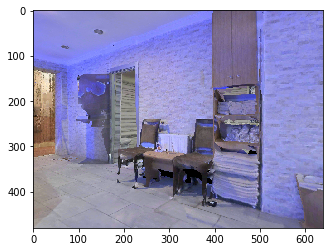

GOAL (DIST, ANG):  [2.13799397 4.35457702]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 4.3546], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3]
cur_time 13.599999999999968
steps 136
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [1.590906]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.6922e-01, -1.2733e-03, -4.9443e-01, -4.9499e-01],
        [-2.9984e-03,  9.9999e-01,  2.6960e-03,  7.

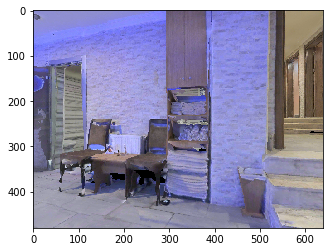

GOAL (DIST, ANG):  [2.13799397 4.61637648]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 4.6164], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3]
cur_time 13.699999999999967
steps 137
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [1.3291066]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.1123e-01, -1.5121e-03, -7.0296e-01, -4.9206e-01],
        [-3.7327e-03,  9.9999e-01,  1.6255e-03,

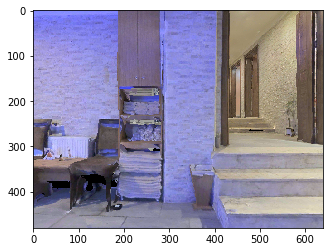

GOAL (DIST, ANG):  [2.13799397 4.87817581]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 4.8782], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3]
cur_time 13.799999999999967
steps 138
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [1.0673072]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-5.0465e-01, -2.2100e-03, -8.6332e-01, -4.8913e-01],
        [-2.8742e-03,  1.0000e+00, -8.7977e-

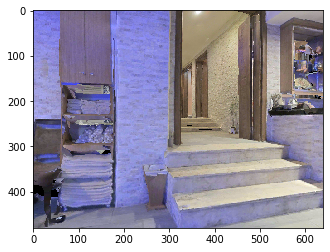

GOAL (DIST, ANG):  [2.13799397 5.13997509]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 5.1400], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3]
cur_time 13.899999999999967
steps 139
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [0.80550796]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-2.6293e-01, -2.1694e-03, -9.6481e-01, -4.8753e-01],
        [-2.9830e-03,  9.9999e-01, -1.43

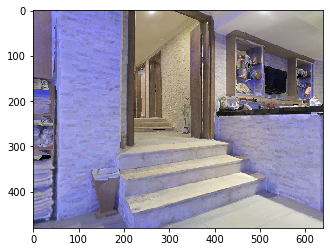

GOAL (DIST, ANG):  [2.13799397 5.40177449]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 5.4018], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 13.999999999999966
steps 140
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [0.54370856]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-5.9655e-03, -1.1954e-03, -9.9998e-01, -4.8666e-01],
        [-2.6759e-03,  1.0000e+00, -1

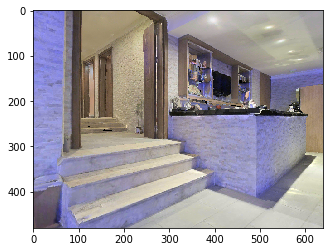

GOAL (DIST, ANG):  [2.13799397 5.66357388]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 5.6636], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 14.099999999999966
steps 141
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [0.28190917]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 2.5271e-01, -1.3230e-03, -9.6754e-01, -4.8442e-01],
        [-1.2485e-03,  1.0000e+00,

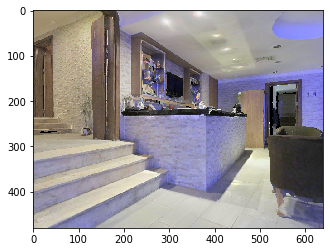

GOAL (DIST, ANG):  [2.13799397 5.92537329]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 5.9254], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 14.199999999999966
steps 142
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [0.02010976]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 4.9477e-01, -5.3407e-04, -8.6902e-01, -4.8312e-01],
        [-5.1885e-04,  1.0000e+

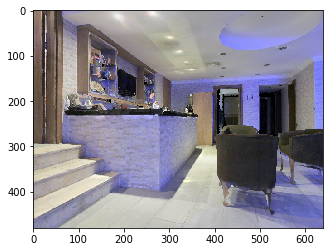

GOAL (DIST, ANG):  [2.13799397 6.18717269]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 6.1872], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 14.299999999999965
steps 143
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [-0.24168964]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.0303e-01,  2.1566e-07, -7.1116e-01, -4.9063e-01],
        [-7.3433e-04,  1.00

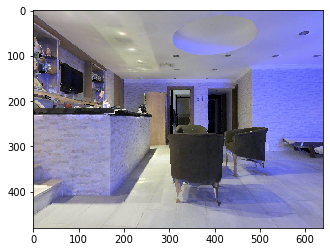

GOAL (DIST, ANG):  [1.88929719 6.17448703]
class observation from goal chair



ostensible observation from goal tensor([1.8893, 6.1745], device='cuda:0')
estimatedGoalPos2D tensor([[258., 184.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
cur_time 14.399999999999965
steps 144
located_true_goal True
gps and compass: [-4.8644876 -2.2726476] [-0.24168964]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.0245e-01, -1.2965e-03, -7.1173e-01, -8.2686e-01],
        [-1.5050e-04,  1

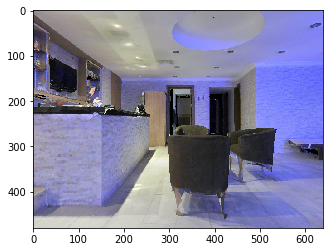

GOAL (DIST, ANG):  [1.64099701 6.15795915]
class observation from goal chair



ostensible observation from goal tensor([1.6410, 6.1580], device='cuda:0')
estimatedGoalPos2D tensor([[260., 182.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1]
cur_time 14.499999999999964
steps 145
located_true_goal True
gps and compass: [-4.621754  -2.2128117] [-0.24168964]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.0295e-01, -2.3713e-03, -7.1124e-01, -1.1755e+00],
        [ 2.1008e-04,

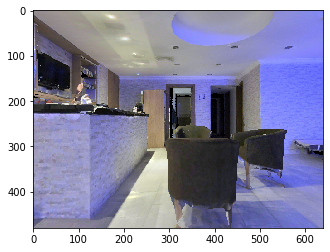

GOAL (DIST, ANG):  [1.39330445 6.13554649]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 6.1355], device='cuda:0')
estimatedGoalPos2D tensor([[261., 180.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1]
cur_time 14.599999999999964
steps 146
located_true_goal True
gps and compass: [-4.37902  -2.152976] [-0.24168964]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.0295e-01, -1.7186e-03, -7.1123e-01, -1.5193e+00],
        [ 7.0871e-05

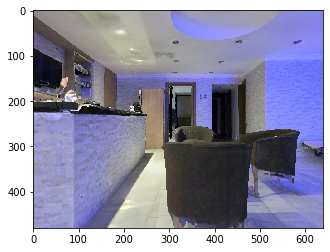

GOAL (DIST, ANG):  [1.39330445 0.11416056]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 0.1142], device='cuda:0')
estimatedGoalPos2D tensor([[262., 174.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3]
cur_time 14.699999999999964
steps 147
located_true_goal True
gps and compass: [-4.37902  -2.152976] [-0.503489]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6298e-01, -1.4664e-03, -5.0524e-01, -1.5155e+00],
        [ 6.2408e-0

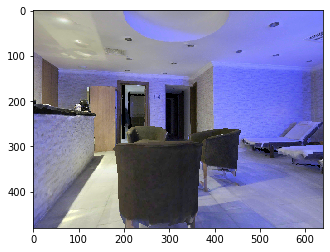

GOAL (DIST, ANG):  [1.14528595 0.13902879]
class observation from goal chair



ostensible observation from goal tensor([1.1453, 0.1390], device='cuda:0')
estimatedGoalPos2D tensor([[263., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1]
cur_time 14.799999999999963
steps 148
located_true_goal True
gps and compass: [-4.160044  -2.0323548] [-0.503489]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6281e-01, -1.6309e-03, -5.0553e-01, -1.7571e+00],
        [ 5.57

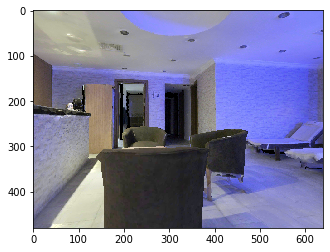

GOAL (DIST, ANG):  [0.89836656 0.17760329]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 0.1776], device='cuda:0')
estimatedGoalPos2D tensor([[265., 177.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1]
cur_time 14.899999999999963
steps 149
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-0.503489]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6264e-01, -1.9537e-03, -5.0582e-01, -1.9990e+00],
        [ 4

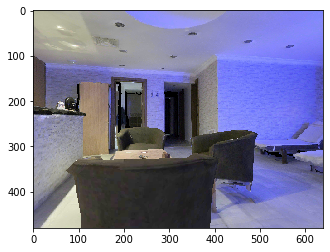

GOAL (DIST, ANG):  [0.89836656 0.43940275]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 0.4394], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3]
cur_time 14.999999999999963
steps 150
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-0.7652885]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.6405e-01, -2.1191e-03, -2.6571e-01, -1.9981e+00],
       

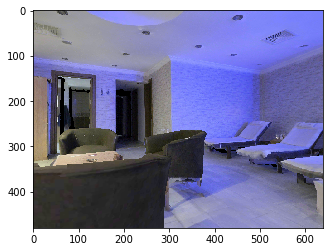

GOAL (DIST, ANG):  [0.89836656 0.70120208]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 0.7012], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3]
cur_time 15.099999999999962
steps 151
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-1.0270878]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.9997e-01, -1.2361e-03, -6.9775e-03, -1.9977e+00],
    

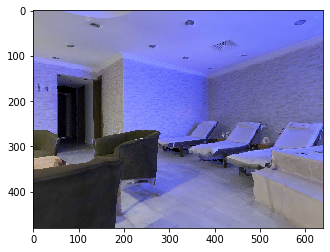

GOAL (DIST, ANG):  [0.89836656 0.96300142]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 0.9630], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3]
cur_time 15.199999999999962
steps 152
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-1.2888871]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 9.6778e-01, -1.9906e-03,  2.5179e-01, -1.9965e+00],
 

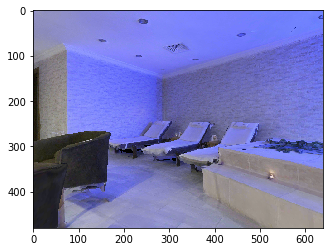

GOAL (DIST, ANG):  [0.89836656 1.22480087]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 1.2248], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3]
cur_time 15.299999999999962
steps 153
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-1.5506866]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 8.6938e-01, -1.0832e-03,  4.9414e-01, -2.0033e+00]

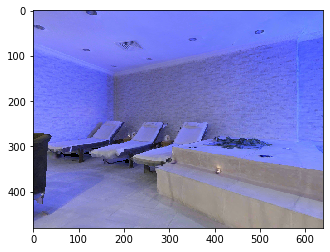

GOAL (DIST, ANG):  [0.89836656 1.48660033]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 1.4866], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3]
cur_time 15.399999999999961
steps 154
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-1.812486]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 7.1219e-01, -6.8461e-04,  7.0199e-01, -2.0008e+0

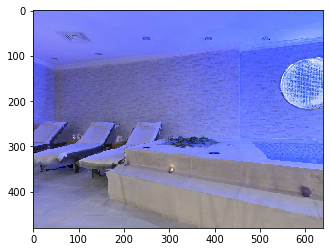

GOAL (DIST, ANG):  [0.89836656 1.74839978]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 1.7484], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3]
cur_time 15.499999999999961
steps 155
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-2.0742855]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 5.0615e-01, -9.7735e-04,  8.6244e-01, -2.002

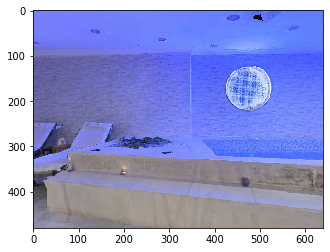

GOAL (DIST, ANG):  [0.89836656 2.01019912]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 2.0102], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3]
cur_time 15.59999999999996
steps 156
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-2.3360848]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 2.6478e-01, -3.3536e-04,  9.6431e-01, -2.0

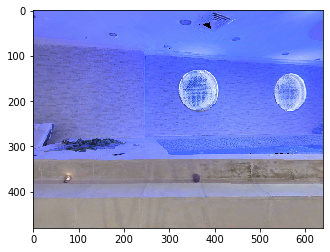

GOAL (DIST, ANG):  [0.89836656 2.27199845]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 2.2720], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 15.69999999999996
steps 157
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-2.5978842]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[ 6.6859e-03, -7.1009e-04,  9.9998e-01, -

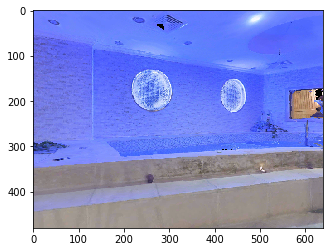

GOAL (DIST, ANG):  [0.89836656 2.53379779]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 2.5338], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 15.79999999999996
steps 158
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-2.8596835]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-2.5229e-01,  8.3165e-05,  9.6765e-01

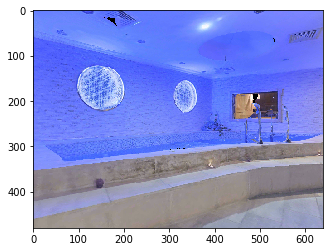

GOAL (DIST, ANG):  [0.89836656 2.79559736]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 2.7956], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 15.89999999999996
steps 159
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-3.121483]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-4.9465e-01, -3.5983e-04,  8.6909e-

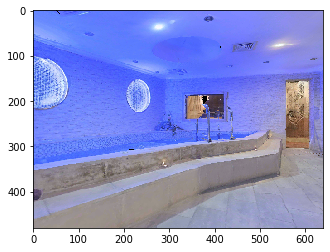

GOAL (DIST, ANG):  [0.89836656 3.05739676]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 3.0574], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 15.99999999999996
steps 160
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [2.8999028]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.0301e-01, -8.6858e-04,  7.111

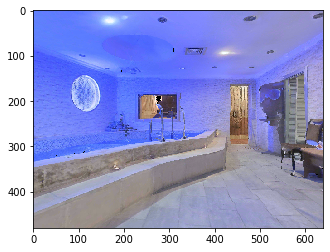

GOAL (DIST, ANG):  [1.14767331 3.07571662]
class observation from goal chair



ostensible observation from goal tensor([1.1477, 3.0757], device='cuda:0')
estimatedGoalPos2D tensor([[271., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
cur_time 16.09999999999996
steps 161
located_true_goal True
gps and compass: [-4.1838017 -1.9715695] [2.8999028]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.0239e-01, -4.1066e-04,  7.

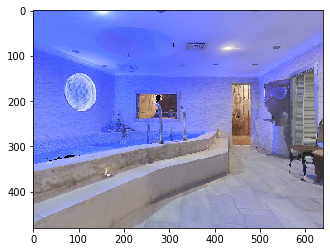

GOAL (DIST, ANG):  [1.39722818 3.08749534]
class observation from goal chair



ostensible observation from goal tensor([1.3972, 3.0875], device='cuda:0')
estimatedGoalPos2D tensor([[269., 174.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1]
cur_time 16.19999999999996
steps 162
located_true_goal True
gps and compass: [-4.4265356 -2.0314054] [2.8999028]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.0218e-01, -1.4091e-04, 

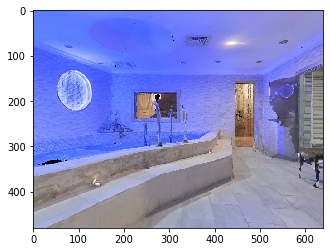

GOAL (DIST, ANG):  [1.64691762 3.09570343]
class observation from goal chair



ostensible observation from goal tensor([1.6469, 3.0957], device='cuda:0')
estimatedGoalPos2D tensor([[267., 176.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1]
cur_time 16.29999999999996
steps 163
located_true_goal True
gps and compass: [-4.669269  -2.0912411] [2.8999028]
my gps location on obs map [210 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-7.0236e-01, -5.9072e-0

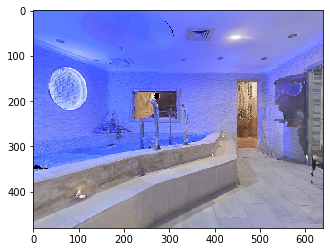

GOAL (DIST, ANG):  [1.64691762 3.35750277]
class observation from goal chair



ostensible observation from goal tensor([1.6469, 3.3575], device='cuda:0')
estimatedGoalPos2D tensor([[261., 177.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3]
cur_time 16.399999999999963
steps 164
located_true_goal True
gps and compass: [-4.669269  -2.0912411] [2.6381035]
my gps location on obs map [210 220], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.6235e-01, -8.636

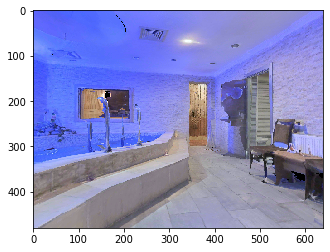

GOAL (DIST, ANG):  [1.89187175 3.3291889 ]
class observation from goal chair



ostensible observation from goal tensor([1.8919, 3.3292], device='cuda:0')
estimatedGoalPos2D tensor([[266., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1]
cur_time 16.499999999999964
steps 165
located_true_goal True
gps and compass: [-4.8882456 -2.2118623] [2.6381035]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.6221e-01, -4.

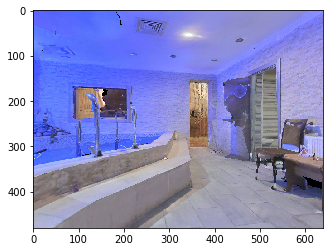

GOAL (DIST, ANG):  [2.13799397 3.30737956]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 3.3074], device='cuda:0')
estimatedGoalPos2D tensor([[264., 179.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1]
cur_time 16.599999999999966
steps 166
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [2.6381035]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.6266e-01, 

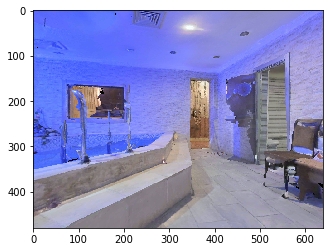

GOAL (DIST, ANG):  [2.13799397 3.5691789 ]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 3.5692], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3]
cur_time 16.699999999999967
steps 167
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [2.3763041]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-9.6394e-0

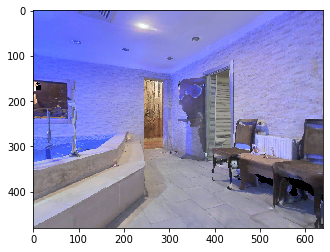

GOAL (DIST, ANG):  [2.13799397 3.83097823]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 3.8310], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3]
cur_time 16.79999999999997
steps 168
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [2.1145048]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-9.9997e

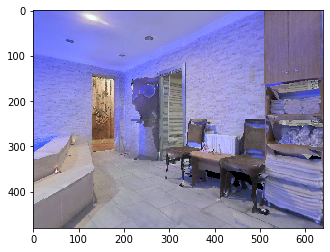

GOAL (DIST, ANG):  [2.13799397 4.09277769]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 4.0928], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3]
cur_time 16.89999999999997
steps 169
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [1.8527054]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-9.67

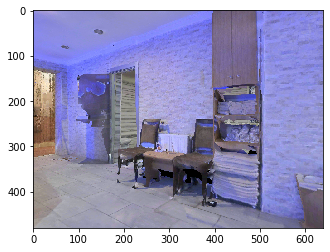

GOAL (DIST, ANG):  [2.13799397 4.35457702]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 4.3546], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3]
cur_time 16.99999999999997
steps 170
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [1.590906]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor([[-8.

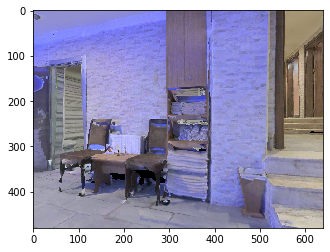

GOAL (DIST, ANG):  [2.13799397 4.61637648]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 4.6164], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3]
cur_time 17.099999999999973
steps 171
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [1.3291066]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tensor(

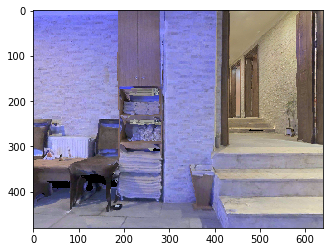

GOAL (DIST, ANG):  [2.13799397 4.87817581]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 4.8782], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3]
cur_time 17.199999999999974
steps 172
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [1.0673072]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init tens

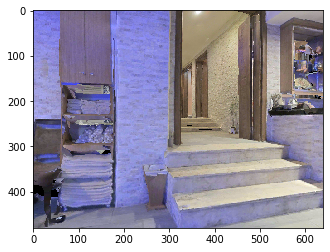

GOAL (DIST, ANG):  [2.13799397 5.13997509]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 5.1400], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3]
cur_time 17.299999999999976
steps 173
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [0.80550796]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_init 

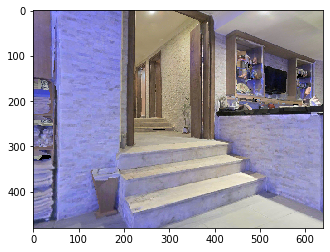

GOAL (DIST, ANG):  [2.13799397 5.40177449]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 5.4018], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 17.399999999999977
steps 174
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [0.54370856]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_in

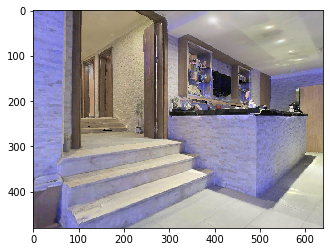

GOAL (DIST, ANG):  [2.13799397 5.66357388]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 5.6636], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 17.49999999999998
steps 175
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [0.28190917]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False


p_

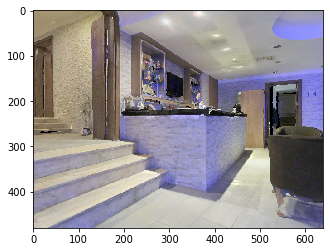

GOAL (DIST, ANG):  [2.13799397 5.92537329]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 5.9254], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 17.59999999999998
steps 176
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [0.02010976]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: False



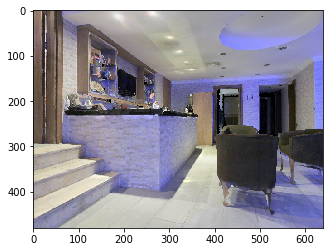

GOAL (DIST, ANG):  [2.13799397 6.18717269]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 6.1872], device='cuda:0')
estimatedGoalPos2D tensor([[256., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 17.69999999999998
steps 177
located_true_goal True
gps and compass: [-5.1072216 -2.3324835] [-0.24168964]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?: Fal

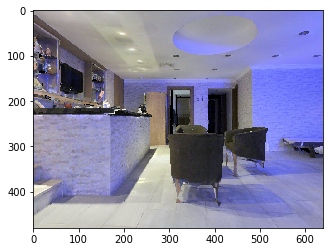

GOAL (DIST, ANG):  [1.88929719 6.17448703]
class observation from goal chair



ostensible observation from goal tensor([1.8893, 6.1745], device='cuda:0')
estimatedGoalPos2D tensor([[258., 184.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
cur_time 17.799999999999983
steps 178
located_true_goal True
gps and compass: [-4.8644876 -2.2726476] [-0.24168964]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspection?:

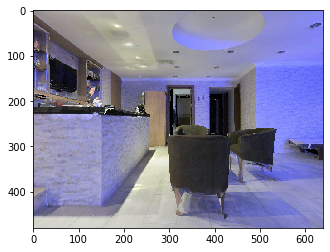

GOAL (DIST, ANG):  [1.64099701 6.15795915]
class observation from goal chair



ostensible observation from goal tensor([1.6410, 6.1580], device='cuda:0')
estimatedGoalPos2D tensor([[260., 182.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1]
cur_time 17.899999999999984
steps 179
located_true_goal True
gps and compass: [-4.621754  -2.2128117] [-0.24168964]
my gps location on obs map [210 210], my path start location on obs map [200 200]


To do list is empty, needs inspectio

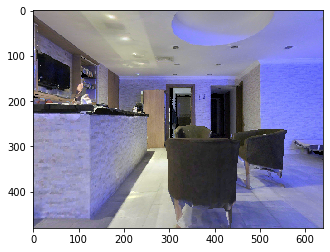

GOAL (DIST, ANG):  [1.39330445 6.13554649]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 6.1355], device='cuda:0')
estimatedGoalPos2D tensor([[261., 180.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1]
cur_time 17.999999999999986
steps 180
located_true_goal True
gps and compass: [-4.37902  -2.152976] [-0.24168964]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspecti

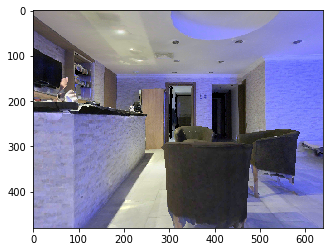

GOAL (DIST, ANG):  [1.39330445 0.11416056]
class observation from goal chair



ostensible observation from goal tensor([1.3933, 0.1142], device='cuda:0')
estimatedGoalPos2D tensor([[262., 174.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3]
cur_time 18.099999999999987
steps 181
located_true_goal True
gps and compass: [-4.37902  -2.152976] [-0.503489]
my gps location on obs map [220 210], my path start location on obs map [200 200]


To do list is empty, needs inspect

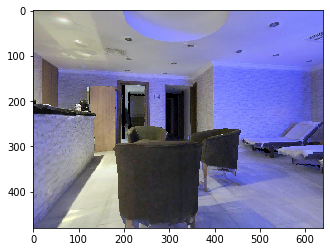

GOAL (DIST, ANG):  [1.14528595 0.13902879]
class observation from goal chair



ostensible observation from goal tensor([1.1453, 0.1390], device='cuda:0')
estimatedGoalPos2D tensor([[263., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1]
cur_time 18.19999999999999
steps 182
located_true_goal True
gps and compass: [-4.160044  -2.0323548] [-0.503489]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs ins

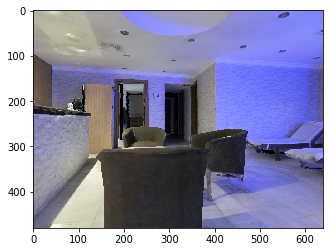

GOAL (DIST, ANG):  [0.89836656 0.17760329]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 0.1776], device='cuda:0')
estimatedGoalPos2D tensor([[265., 177.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1]
cur_time 18.29999999999999
steps 183
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-0.503489]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, needs 

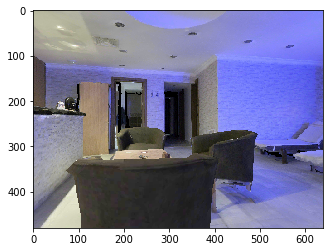

GOAL (DIST, ANG):  [0.89836656 0.43940275]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 0.4394], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3]
cur_time 18.39999999999999
steps 184
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-0.7652885]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, ne

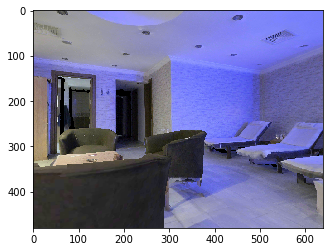

GOAL (DIST, ANG):  [0.89836656 0.70120208]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 0.7012], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3]
cur_time 18.499999999999993
steps 185
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-1.0270878]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty

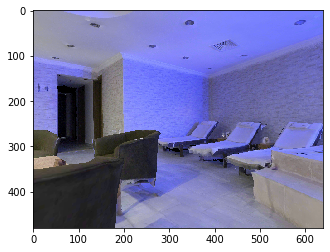

GOAL (DIST, ANG):  [0.89836656 0.96300142]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 0.9630], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3]
cur_time 18.599999999999994
steps 186
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-1.2888871]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is em

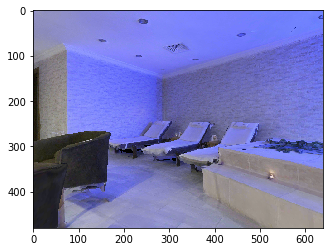

GOAL (DIST, ANG):  [0.89836656 1.22480087]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 1.2248], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3]
cur_time 18.699999999999996
steps 187
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-1.5506866]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is

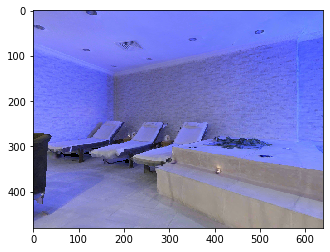

GOAL (DIST, ANG):  [0.89836656 1.48660033]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 1.4866], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3]
cur_time 18.799999999999997
steps 188
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-1.812486]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list 

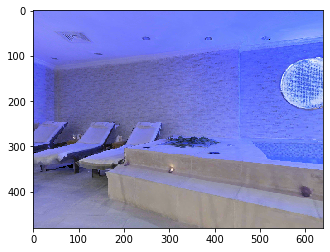

GOAL (DIST, ANG):  [0.89836656 1.74839978]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 1.7484], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3]
cur_time 18.9
steps 189
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-2.0742855]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empty, 

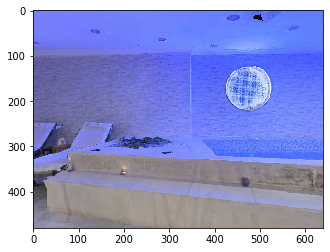

GOAL (DIST, ANG):  [0.89836656 2.01019912]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 2.0102], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3]
cur_time 19.0
steps 190
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-2.3360848]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is empt

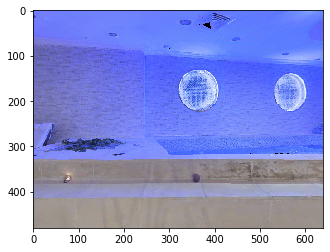

GOAL (DIST, ANG):  [0.89836656 2.27199845]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 2.2720], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 19.1
steps 191
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-2.5978842]
my gps location on obs map [220 220], my path start location on obs map [200 200]


To do list is e

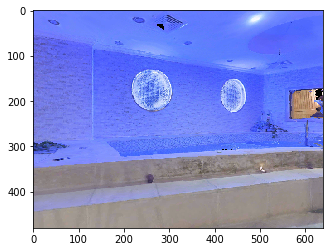

GOAL (DIST, ANG):  [0.89836656 2.53379779]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 2.5338], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 19.200000000000003
steps 192
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-2.8596835]
my gps location on obs map [220 220], my path start location on obs map [200 200]


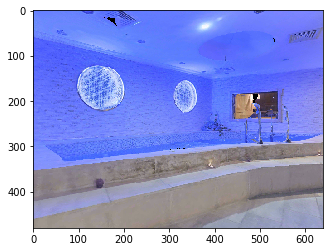

GOAL (DIST, ANG):  [0.89836656 2.79559736]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 2.7956], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 19.300000000000004
steps 193
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [-3.121483]
my gps location on obs map [220 220], my path start location on obs map [200 200

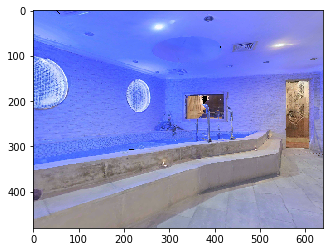

GOAL (DIST, ANG):  [0.89836656 3.05739676]
class observation from goal chair



ostensible observation from goal tensor([0.8984, 3.0574], device='cuda:0')
estimatedGoalPos2D tensor([[267., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3]
cur_time 19.400000000000006
steps 194
located_true_goal True
gps and compass: [-3.9410682 -1.9117336] [2.8999028]
my gps location on obs map [220 220], my path start location on obs map [200 

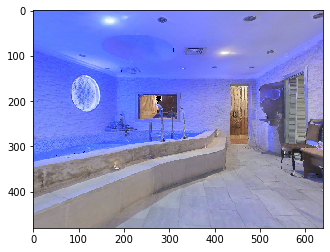

GOAL (DIST, ANG):  [1.14767331 3.07571662]
class observation from goal chair



ostensible observation from goal tensor([1.1477, 3.0757], device='cuda:0')
estimatedGoalPos2D tensor([[271., 173.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1]
cur_time 19.500000000000007
steps 195
located_true_goal True
gps and compass: [-4.1838017 -1.9715695] [2.8999028]
my gps location on obs map [220 220], my path start location on obs map [2

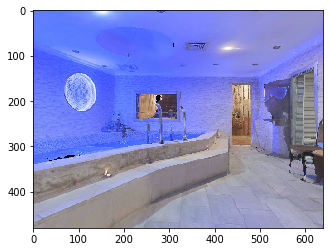

GOAL (DIST, ANG):  [1.39722818 3.08749534]
class observation from goal chair



ostensible observation from goal tensor([1.3972, 3.0875], device='cuda:0')
estimatedGoalPos2D tensor([[269., 174.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1]
cur_time 19.60000000000001
steps 196
located_true_goal True
gps and compass: [-4.4265356 -2.0314054] [2.8999028]
my gps location on obs map [220 220], my path start location on obs map 

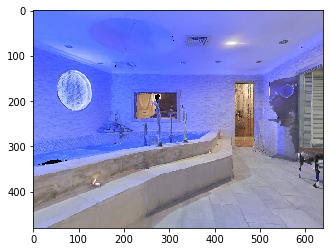

GOAL (DIST, ANG):  [1.64691815 3.09570338]
class observation from goal chair



ostensible observation from goal tensor([1.6469, 3.0957], device='cuda:0')
estimatedGoalPos2D tensor([[267., 176.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1]
cur_time 19.70000000000001
steps 197
located_true_goal True
gps and compass: [-4.6692696 -2.0912414] [2.8999028]
my gps location on obs map [210 220], my path start location on obs m

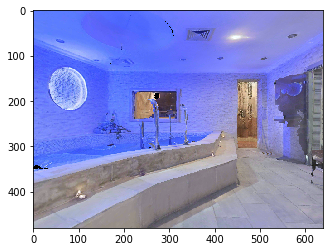

GOAL (DIST, ANG):  [1.64691815 3.35750271]
class observation from goal chair



ostensible observation from goal tensor([1.6469, 3.3575], device='cuda:0')
estimatedGoalPos2D tensor([[261., 177.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3]
cur_time 19.80000000000001
steps 198
located_true_goal True
gps and compass: [-4.6692696 -2.0912414] [2.6381035]
my gps location on obs map [210 220], my path start location on ob

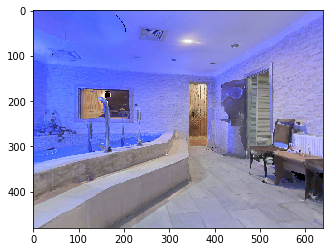

GOAL (DIST, ANG):  [1.89187182 3.32918878]
class observation from goal chair



ostensible observation from goal tensor([1.8919, 3.3292], device='cuda:0')
estimatedGoalPos2D tensor([[266., 178.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1]
cur_time 19.900000000000013
steps 199
located_true_goal True
gps and compass: [-4.8882456 -2.2118626] [2.6381035]
my gps location on obs map [210 210], my path start location o

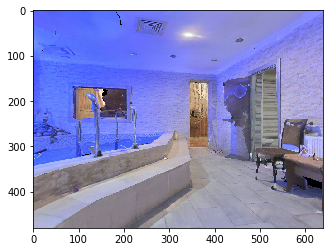

GOAL (DIST, ANG):  [2.13799442 3.30737964]
class observation from goal chair



ostensible observation from goal tensor([2.1380, 3.3074], device='cuda:0')
estimatedGoalPos2D tensor([[264., 179.]], device='cuda:0')
action_history [2, 1, 3, 1, 1, 1, 1, 1, 2, 1, 1, 2, 1, 1, 2, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 3, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 3, 1, 1]
cur_time 20.000000000000014
steps 200
located_true_goal True
gps and compass: [-5.107222  -2.3324835] [2.6381035]
my gps location on obs map [210 210], my path start locatio

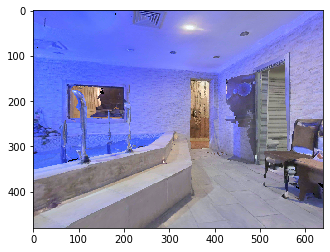

episode over after 200 steps


{'distance_to_goal': 1.1528443098068237,
 'success': 0.0,
 'spl': 0.0,
 'softspl': 0.20223152502666664}

In [17]:
from collections import defaultdict
from typing import Dict, Optional
import quaternion
%matplotlib inline

agg_metrics: Dict = defaultdict(float)

#observations = env.reset()
rtra = [-0.5, 0.04610800743103027, 3.0]
ang = -0.8
rrot = quaternion.from_euler_angles(np.array([0, ang, 0]))
env._sim.get_observations_at(position=rtra, rotation=rrot, keep_agent_at_new_pose=True)

num_episodes = len(env.episodes)
count_episodes = 0
max_steps = 200
while count_episodes < num_episodes:
    agent.reset()
    observations = env.step(HabitatSimActions.MOVE_FORWARD)
    num_steps = 0
    plt.imshow(observations['rgb'])
    plt.show()
    while not env.episode_over and num_steps < max_steps:
        # observations['depth'] = observations['depth'] * (dmax - dmin) + dmin
        action = agent.act(observations)
        plt.imshow(observations['rgb'])
        plt.show()
        observations = env.step(action)
        # manually set goal to be chair
        observations['objectgoal'] = [0]
        num_steps += 1
    print("episode over after {} steps".format(num_steps))

    metrics = env.get_metrics()
    for m, v in metrics.items():
        agg_metrics[m] += v
    count_episodes += 1

avg_metrics = {k: v / count_episodes for k, v in agg_metrics.items()}
avg_metrics

In [ ]:
num_steps = 0
while not env.episode_over and num_steps < max_steps:
    # observations['depth'] = observations['depth'] * (dmax - dmin) + dmin
    action = agent.act(observations)
    observations = env.step(action)
    num_steps += 1
print("episode over after {} steps".format(num_steps))

metrics = env.get_metrics()
for m, v in metrics.items():
    agg_metrics[m] += v
count_episodes += 1

In [ ]:
max_steps = 10

action_mapping = {
    #0: 'stop',
    1: 'move_forward',
    2: 'turn left',
    #3: 'turn right'
}

for i in range(len(env.episodes)):
    observations = env.reset()
    display_sample(observations['rgb'], observations.get('depth'), np.squeeze(observations['depth']))
    
    count_steps = 0
    while count_steps < max_steps:
        action = random.choice(list(action_mapping.keys()))
        print(action_mapping[action])
        observations = env.step(action)
        print('rgb mean:', observations['rgb'].mean())
        display_sample(observations['rgb'], observations.get('depth'), np.squeeze(observations['depth']))

        count_steps += 1
        if env.episode_over:
            break

In [ ]:
agent.map2DObstacles

In [ ]:
obs_map = agent.map2DObstacles.cpu().numpy()[0,0]
map_scale = 40
plt.figure()
plt.imshow(obs_map[200-map_scale:200+map_scale, 180-map_scale:200+map_scale])

In [ ]:
env.close()

In [ ]:
benchmark = habitat.Benchmark(args.task_config)
metrics = benchmark.evaluate(agent)
for k, v in metrics.items():
    habitat.logger.info("{}: {:.3f}".format(k, v))
    print(k, v)